# Blackjack game with SARSA

Reinforcement learning project of Artificial Intelligence for Robotics of the master's course in Robotics Engineering at University of Genoa, curated by Alessandro Trovatello.

The aim of the project was to use the reinforcement learning to implement an Agent able to improve their skills to play at blackjack, using the SARSA algorithm. The template was given by the professor and it's a custom openAI's Blackjack without the Agent. The Agent is fully created from zero and it is created using the SARSA (State-Action-Reward-nextState-nextAction) method.

## Blackjack game

The goal of the game is to beat the dealer by having a hand value of 21 or closest to 21 without going over. Each player is dealt two cards, and then has the option to "hit" and receive additional cards to improve their hand. They can also choose to “stand” and keep the cards they have. If the player exceeds 21, they “bust” and automatically lose the round. If the player has exactly 21, they automatically win. Otherwise, the player wins if they are closer to 21 than the dealer. \
The value of each card is listed below:
- 10/Jack/Queen/King → 10
- 2 through 9 → Same value as card
- Ace → 1 or 11 (Player’s choice)

The game starts with players making their bets, after which the dealer will deal two cards to each player and two to himself, with one card face up and one face down (known as the "hole" card). Players then make their decisions to hit or stand. Once all players have completed their turns, the dealer will reveal their hole card and hit or stand according to a set of rules. If the dealer busts (goes over 21), players who have not bust win. If neither the player nor dealer busts, the hand closest to 21 wins.

## Importing modules

The modules used here are to call the openAI environment, with `gym`, and the basic plotting scheme with `matplotlib` module. `random` is used as the main part regarding the cards dealing and other necessary data management.


In [1]:
import gym
from gym import spaces
import numpy as np
import matplotlib.pyplot as plt
import random
import enum

## Setting up the basics of the game

### Card and deck

The cards' definitions are set up below. 
- `ranks`: a dictionary that maps the string representations of card ranks to their numerical values
- `Suit`: an enumeration of the four suits in a standard deck of playing cards
- `Card`: a class that represents an individual card and contains properties such as the card's suit, rank, and value
- `Deck`: a class that represents a deck of cards and contains methods for shuffling the deck, dealing cards, peeking at the top card, adding cards to the bottom of the deck, and printing the deck

The `Deck` class initializes an empty list of cards when created and populates it with `num` standard decks of playing cards. The `shuffle` method randomly shuffles the cards in the deck. The `deal` method returns the top card of the deck, and the `peek` method returns the top card without removing it from the deck. The `add_to_bottom` method adds a card to the bottom of the deck, and the `__str__` method returns a string representation of the deck. The `__len__` method returns the number of cards in the deck.

In [2]:
ranks = {
    "two" : 2,
    "three" : 3,
    "four" : 4,
    "five" : 5,
    "six" : 6,
    "seven" : 7,
    "eight" : 8,
    "nine" : 9,
    "ten" : 10,
    "jack" : 10,
    "queen" : 10,
    "king" : 10,
    "ace" : (1, 11)
    }

class Suit(enum.Enum):
    spades = "spades"
    clubs = "clubs"
    diamonds = "diamonds"
    hearts = "hearts"
    
class Card:
    def __init__(self, suit, rank, value):
        self.suit = suit
        self.rank = rank
        self.value = value
        
    def __str__(self):
        return self.rank + " of " + self.suit.value
    
class Deck:
    def __init__(self, num=1):
        self.cards = []
        for i in range(num):
            for suit in Suit:
                for rank, value in ranks.items():
                    self.cards.append(Card(suit, rank, value))
                
    def shuffle(self):
        random.shuffle(self.cards)
        
    def deal(self):
        return self.cards.pop(0)
    
    def peek(self):
        if len(self.cards) > 0:
            return self.cards[0]
        
    def add_to_bottom(self, card):
        self.cards.append(card)
        
    def __str__(self):
        result = ""
        for card in self.cards:
            result += str(card) + "\n"
        return result
    
    def __len__(self):
        return len(self.cards)

### Setting up the game's rules

The evaluation of the dealer's hand is done here, following a proper set of rules that are predictable. As the game goes, the dealer will be following *Hard 17* rule. This means the dealer will not hit again if the Ace yields a 17. This also means that Aces initially declared as 11's can be changed to 1's as new cards come.

In [3]:
def dealer_eval(player_hand):
    num_ace = 0
    use_one = 0
    for card in player_hand:
        if card.rank == "ace":
            num_ace += 1
            use_one += card.value[0] # It will be using Ace is equal to 1 in here
        else:
            use_one += card.value
    
    if num_ace > 0:
        ace_counter = 0
        while ace_counter < num_ace:
            use_eleven = use_one + 10 
            
            if use_eleven > 21:
                return use_one
            elif use_eleven >= 17 and use_eleven <= 21:
                return use_eleven
            else:
                use_one = use_eleven
            
            ace_counter += 1
        
        return use_one
    else:
        return use_one

As for the evaluation of the player's hand, it focus on the value of Ace. For instance, if the Ace obtained gets the player to the total sum of 18 to 21, then Ace is equal to 11, otherwise it is equal to 1.

In [4]:
def player_eval(player_hand):
    num_ace = 0
    use_one = 0
    for card in player_hand:
        if card.rank == "ace":
            num_ace += 1
            use_one += card.value[0] # It will be using Ace is equal to 1 in here
        else:
            use_one += card.value
    
    if num_ace > 0:
        ace_counter = 0
        while ace_counter < num_ace:
            use_eleven = use_one + 10 
            
            if use_eleven > 21:
                return use_one
            elif use_eleven >= 18 and use_eleven <= 21:
                return use_eleven
            else:
                use_one = use_eleven
            
            ace_counter += 1
        
        return use_one
    else:
        return use_one

Below, the code for the logic in which the dealer will follow is presented. As the action is rather straightforward, nothing much happens. Following the Hard 17 rule, the dealer will stop hitting after the total is 17 or more.

In [5]:
def dealer_turn(dealer_hand, deck, player_value):
    dealer_value = dealer_eval(dealer_hand)
    while dealer_value < 17 and player_value <= 21:
        dealer_hand.append(deck.deal()) # Making the Hit
        dealer_value = dealer_eval(dealer_hand)

    return dealer_value, dealer_hand, deck

## Setting up the OpenAI environment for Blackjack

The solution is to create a custom class in order to train the bot.

The class has two main attributes:
- the `action_space` attribute, which is a 2-element discrete space representing the two possible actions the player can take: hit (0) or stand (1)
- the `observation_space` attribute, which is a tuple representing the state of the game, consisting of two elements: player hand value (18 possible values ranging from 3 to 20) and the dealer's upcard value (10 possible values ranging from 2 to 11).

The class also implements four main methods:

- `step(action)` method, which takes the player's action as an input, updates the game state, calculates the reward, and returns the new state and the reward.
- `reset()` method, which resets the game to its initial state and returns the start state.
- `_take_action(action)` method, which updates the player's hand according to the player's action.
- `dealer_turn(dealer_hand, bj_deck)` method, which calculates the dealer's final hand value according to the dealer's rules.

The game starts with an initial balance of 1000, and a deck of cards made up of 6 decks. The deck is initialized using the `Deck` class. The game can end in three ways: the player stands, the player's hand value exceeds 21, or the dealer's hand value exceeds 21. The rewards are -1 for losing, 0 for tie, and 1 for winning.

In [6]:
INITIAL_BALANCE = 1000
NUM_DECKS = 6

class BlackjackEnv(gym.Env):
    metadata = {'render.modes': ['human']}
    
    def __init__(self):
        super(BlackjackEnv, self).__init__()
        
        # Initialize the blackjack deck.
        self.bj_deck = Deck(NUM_DECKS)
        
        self.player_hand = []
        self.dealer_hand = []
        
        self.reward_options = {"lose":-1, "tie":0, "win":1}
        
        # hit = 0, stand = 1
        self.action_space = spaces.Discrete(2)
        
        # Second element of the tuple is the range of possible values for the dealer's upcard. (2 through 11)
        self.observation_space = spaces.Tuple((spaces.Discrete(18), spaces.Discrete(10)))
        self.balance = INITIAL_BALANCE
        self.done = False
        
    def _take_action(self, action):
        if action == 0: # hit
            self.player_hand.append(self.bj_deck.deal())
            
        # re-calculate the value of the player's hand after any changes to the hand.
        self.player_value = player_eval(self.player_hand)
    
    def step(self, action):
        self._take_action(action)
        
        # End the episode/game is the player stands or has a hand value >= 21.
        self.done = action == 1 or self.player_value >= 21
        
        # rewards are 0 when the player hits and is still below 21, and they keep playing.
        rewards = 0
        
        if self.done:
            # CALCULATE REWARDS
            if self.player_value > 21: # above 21, player loses automatically.
                rewards = self.reward_options["lose"]
            elif self.player_value == 21: # blackjack! Player wins automatically.
                rewards = self.reward_options["win"]
            else:
                ## Begin dealer turn phase.

                dealer_value, self.dealer_hand, self.bj_deck = dealer_turn(self.dealer_hand, self.bj_deck, self.player_value)
                
                ## End of dealer turn phase

                #------------------------------------------------------------#

                ## Final Compare

                if dealer_value > 21: # dealer above 21, player wins automatically
                    rewards = self.reward_options["win"]
                elif dealer_value == 21: # dealer has blackjack, player loses automatically
                    rewards = self.reward_options["lose"]
                else: # dealer and player have values less than 21.
                    if self.player_value > dealer_value: # player closer to 21, player wins.
                        rewards = self.reward_options["win"]
                    elif self.player_value < dealer_value: # dealer closer to 21, dealer wins.
                        rewards = self.reward_options["lose"]
                    else:
                        rewards = self.reward_options["tie"]
        
        self.balance += rewards
        
        
        # Subtract by 1 to fit into the possible observation range.
        # This makes the possible range of 3 through 20 into 1 through 18
        player_value_obs = self.player_value - 2
        
        # get the value of the dealer's upcard, this value is what the agent sees.
        # Subtract by 1 to fit the possible observation range of 1 to 10.
        upcard_value_obs = dealer_eval([self.dealer_upcard]) - 1
        
        # the state is represented as a player hand-value + dealer upcard pair.
        obs = np.array([player_value_obs, upcard_value_obs])
        
        return obs, rewards, self.done, {}
    
    def reset(self): # resets game to an initial state
        # Add the player and dealer cards back into the deck.
        self.bj_deck.cards += self.player_hand + self.dealer_hand

        # Shuffle before beginning. Only shuffle once before the start of each game.
        self.bj_deck.shuffle()
         
        #self.balance = INITIAL_BALANCE
        
        self.done = False
        
        # returns the start state for the agent
        # deal 2 cards to the agent and the dealer
        self.player_hand = [self.bj_deck.deal(), self.bj_deck.deal()]
        self.dealer_hand = [self.bj_deck.deal(), self.bj_deck.deal()]
        self.dealer_upcard = self.dealer_hand[0]
        
        # calculate the value of the agent's hand
        self.player_value = player_eval(self.player_hand)
        
        # Subtract by 1 to fit into the possible observation range.
        # This makes the possible range of 2 through 20 into 1 through 18
        player_value_obs = self.player_value - 2
            
        # get the value of the dealer's upcard, this value is what the agent sees.
        # Subtract by 1 to fit the possible observation range of 1 to 10.
        upcard_value_obs = dealer_eval([self.dealer_upcard]) - 1
        
        # the state is represented as a player hand-value + dealer upcard pair.
        obs = np.array([player_value_obs, upcard_value_obs])
        
        return obs
    
    def render(self, mode='human', close=False):
        # convert the player hand into a format that is
        # easy to read and understand.
        hand_list = []
        hand_list_dealer = []
        for card in self.player_hand:
            hand_list.append(card.rank)
        

            
        # re-calculate the value of the dealer upcard.
        upcard_value = dealer_eval([self.dealer_upcard])
        
        # Print the dealer_value.
        dealer_value, _, _ = dealer_turn(self.dealer_hand, self.bj_deck, self.player_value)
        
        for card in self.dealer_hand:
            hand_list_dealer.append(card.rank)
            
        print(f'Balance: {self.balance}')
        print(f'Player Hand: {hand_list}')
        print(f'Player Value: {self.player_value}')
        print(f'Dealer Upcard: {upcard_value}')
        print(f'Dealer Hand: {hand_list_dealer}')
        print(f'Dealer Value: {dealer_value}')
        print(f'Done: {self.done}')
        
        print()

After the environment for Blackjack is created, it is necessary to create the Agent, or bot, that will learn how to play the game.

With the learning method of choice defined as the **SARSA**, a class `Agent` represents a reinforcement learning agent that can learn from its environment through trial and error. The agent has various attributes such as the environment it interacts with, its exploration factor `epsilon`, learning rate `alpha`, discount factor `gamma`, and the number of episodes it needs to train on `num_episodes_to_train`. The `Agent` class has several methods that allow it to learn from its interactions with the environment:
- `update_parameters` method: This method updates the exploration factor epsilon and the learning rate alpha after each action the agent takes. The epsilon decreases over time and the agent becomes less explorative as it trains, so that it takes more exploitation-based decisions in the future.

- `create_Q_if_new_observation` method: If the agent encounters a new observation, it sets the initial values of the Q-values for each action to 0.0. The Q-values represent the expected long-term reward of taking a specific action in a specific observation.

- `get_maxQ` method: Given an observation, this method returns the maximum Q-value of all the actions that the agent can take.

- `choose_action` method: Based on the current observation, the agent uses this method to choose an action to take. If a random number is greater than the exploration factor epsilon, the agent chooses the action with the highest Q-value. Otherwise, it takes a random action.

- `learn` method: This method updates the Q-value of the action the agent took based on the reward it received and the utility of the next observation. The new Q-value is computed using a formula that combines the current Q-value with the reward and the discounted utility of the next observation.

In [61]:
class Agent:
    def __init__(self, env, epsilon=1.0, alpha=0.1, gamma=0.1, num_episodes_to_train=10000): 
        self.env = env
        self.epsilon = epsilon  # Exploration factor
        self.alpha = alpha  # Learning rate
        self.gamma = gamma  # Discount factor
        self.num_episodes_to_train = num_episodes_to_train
        self.Q = {}  # Q-values table
        self.list_avg = []

    def update_parameters(self, episode):
        # Decrease exploration factor epsilon over time
        self.epsilon = max(0.1, min(1.0, 1.0 - np.log10((episode + 1) / 25)))
        # Update learning rate alpha
        self.alpha = max(0.1, min(1.0, 1.0 - np.log10((episode + 1) / 25)))
        
    def create_Q_if_new_observation(self, observation):
        if observation not in self.Q:
            self.Q[observation] = [0.0, 0.0]  # Initialize Q-values to 0 for both actions
            
    def get_maxQ(self, observation):
        self.create_Q_if_new_observation(observation)
        return max(self.Q[observation])

    def choose_action(self, observation):
        self.create_Q_if_new_observation(observation)

        if np.random.rand() < self.epsilon:
            return self.env.action_space.sample()  # Exploration: choose a random action
        else:
            maxQ = self.get_maxQ(observation)
            return np.argmax(self.Q[observation])  # Exploitation: choose the action with the highest Q-value

    def learn(self, state, action, reward, next_state, next_action):
        self.create_Q_if_new_observation(next_state)

        # SARSA update rule
        self.Q[state][action] = self.Q[state][action] + self.alpha * (
                reward + self.gamma * self.Q[next_state][next_action] - self.Q[state][action])
            
    def train(self):
        total_win_per_episodes = 0
        avg_win = 0
        count = 0
        self.env.balance = INITIAL_BALANCE
        
        for episode in range(self.num_episodes_to_train):
            state = self.env.reset()
            state = tuple(state)

            action = self.choose_action(state)

            total_reward = 0
            count += 1
            
            while True:
                next_state, reward, done, _ = self.env.step(action)
                next_state = tuple(next_state)
                next_action = self.choose_action(next_state)
                
                total_reward += reward
                
                if reward == 1:
                    total_win_per_episodes += reward
                
                # Learn from the experience
                self.learn(state, action, reward, next_state, next_action)

                state = next_state
                action = next_action
            
                if done:
                    break
            # Update exploration and learning rates
            #self.update_parameters(episode)
            
            #if episode % 10 == 0:
                
                # Calculate the winning average
                #avg_win = total_win / self.num_episodes_to_train
                #print(f"Episode: {episode}, Win Rate: {avg_win * 100}")
            
            #print(f"Episode: {episode}, Win Rate: {avg_win * 100}")
            #avg_win = total_win / 100
            #list_avg.append(avg_win)
            #total_win = 0
            env.render()
            # Print episode information
            #if episode % 1000 == 0 and not episode == 1:
            if count == 1000:
                avg_win = total_win_per_episodes / 1000
                self.list_avg.append(avg_win)
                self.update_parameters(episode)
                total_win_per_episodes = 0
                count = 0

        #print(f"Episode: {episode}, Win Rate: {avg_win * 100}")
        avg_run = moving_average(self.list_avg)
        plt.figure(figsize=(10,6))
        plt.plot(self.list_avg, 'k-')
        plt.plot(avg_run, 'r-')
        plt.xlabel('Episodes')
        plt.ylabel('Win rate')
        plt.show()
            

    def test(self, num_episodes=1000):
        total_rewards = 0 # Count the total rewards
        total_win = 0 # Count the number of wins
        i = 0 # Count the number of episodes
        self.epsilon = 0 # Set exploration factor to zero to test

        for i in range(num_episodes):
            state = tuple(self.env.reset()) # Reset the environment and convert the state to tuple
            action = self.choose_action(state)
            
            while True:
                next_state, reward, done, _ = self.env.step(action)
                next_state = tuple(next_state)
                action = self.choose_action(next_state)

                total_rewards += reward
                if reward == 1:
                    total_win += reward
                    
                if done:
                    break
            
        average_reward = total_rewards / num_episodes
        avg_win = total_win / num_episodes
        print(f"Average Win Rate over {num_episodes} episodes: {avg_win * 100}")
    

In [62]:
# Create Blackjack environment
env = BlackjackEnv()

In [63]:
# Create SARSA agent
sarsa_agent = Agent(env, epsilon=1.0, alpha=0.1, gamma=0.1, num_episodes_to_train=100000) 

In [37]:
print(sarsa_agent.list_avg)

[]


In [38]:
def moving_average(lst, window_size=100):
    return [sum(lst[i:i+window_size])/window_size for i in range(len(lst)-window_size+1)]

Balance: 999
Player Hand: ['four', 'six']
Player Value: 10
Dealer Upcard: 10
Dealer Hand: ['ten', 'queen']
Dealer Value: 20
Done: True

Balance: 998
Player Hand: ['six', 'seven', 'three']
Player Value: 16
Dealer Upcard: 10
Dealer Hand: ['jack', 'three', 'ace', 'three']
Dealer Value: 17
Done: True

Balance: 997
Player Hand: ['four', 'ten', 'five', 'nine']
Player Value: 28
Dealer Upcard: 4
Dealer Hand: ['four', 'king']
Dealer Value: 14
Done: True

Balance: 998
Player Hand: ['queen', 'four']
Player Value: 14
Dealer Upcard: 5
Dealer Hand: ['five', 'queen', 'nine']
Dealer Value: 24
Done: True

Balance: 999
Player Hand: ['king', 'three', 'ace']
Player Value: 14
Dealer Upcard: 10
Dealer Hand: ['king', 'five', 'eight']
Dealer Value: 23
Done: True

Balance: 999
Player Hand: ['jack', 'seven']
Player Value: 17
Dealer Upcard: 2
Dealer Hand: ['two', 'nine', 'six']
Dealer Value: 17
Done: True

Balance: 998
Player Hand: ['two', 'four']
Player Value: 6
Dealer Upcard: 10
Dealer Hand: ['jack', 'eight']


Balance: 704
Player Hand: ['seven', 'ten', 'two', 'four']
Player Value: 23
Dealer Upcard: 8
Dealer Hand: ['eight', 'king']
Dealer Value: 18
Done: True

Balance: 703
Player Hand: ['five', 'six']
Player Value: 11
Dealer Upcard: 9
Dealer Hand: ['nine', 'seven', 'three']
Dealer Value: 19
Done: True

Balance: 702
Player Hand: ['five', 'six']
Player Value: 11
Dealer Upcard: 11
Dealer Hand: ['ace', 'seven']
Dealer Value: 18
Done: True

Balance: 701
Player Hand: ['jack', 'two']
Player Value: 12
Dealer Upcard: 3
Dealer Hand: ['three', 'five', 'five', 'six']
Dealer Value: 19
Done: True

Balance: 700
Player Hand: ['jack', 'five']
Player Value: 15
Dealer Upcard: 11
Dealer Hand: ['ace', 'nine']
Dealer Value: 20
Done: True

Balance: 701
Player Hand: ['five', 'king']
Player Value: 15
Dealer Upcard: 11
Dealer Hand: ['ace', 'two', 'king', 'two', 'ten']
Dealer Value: 25
Done: True

Balance: 702
Player Hand: ['four', 'jack']
Player Value: 14
Dealer Upcard: 10
Dealer Hand: ['king', 'four', 'eight']
Dealer

Balance: 511
Player Hand: ['queen', 'ten']
Player Value: 20
Dealer Upcard: 4
Dealer Hand: ['four', 'ten', 'ten']
Dealer Value: 24
Done: True

Balance: 510
Player Hand: ['king', 'four', 'ten']
Player Value: 24
Dealer Upcard: 10
Dealer Hand: ['king', 'six']
Dealer Value: 16
Done: True

Balance: 509
Player Hand: ['five', 'ten']
Player Value: 15
Dealer Upcard: 2
Dealer Hand: ['two', 'seven', 'eight']
Dealer Value: 17
Done: True

Balance: 508
Player Hand: ['nine', 'eight']
Player Value: 17
Dealer Upcard: 8
Dealer Hand: ['eight', 'jack']
Dealer Value: 18
Done: True

Balance: 508
Player Hand: ['king', 'seven', 'three']
Player Value: 20
Dealer Upcard: 10
Dealer Hand: ['jack', 'king']
Dealer Value: 20
Done: True

Balance: 509
Player Hand: ['nine', 'ten']
Player Value: 19
Dealer Upcard: 7
Dealer Hand: ['seven', 'three', 'five', 'ten']
Dealer Value: 25
Done: True

Balance: 510
Player Hand: ['eight', 'six']
Player Value: 14
Dealer Upcard: 5
Dealer Hand: ['five', 'queen', 'seven']
Dealer Value: 22


Balance: 457
Player Hand: ['ten', 'jack']
Player Value: 20
Dealer Upcard: 4
Dealer Hand: ['four', 'nine', 'queen']
Dealer Value: 23
Done: True

Balance: 456
Player Hand: ['seven', 'ten']
Player Value: 17
Dealer Upcard: 2
Dealer Hand: ['two', 'four', 'queen', 'three']
Dealer Value: 19
Done: True

Balance: 455
Player Hand: ['five', 'ace']
Player Value: 16
Dealer Upcard: 10
Dealer Hand: ['ten', 'king']
Dealer Value: 20
Done: True

Balance: 454
Player Hand: ['nine', 'eight', 'ten']
Player Value: 27
Dealer Upcard: 9
Dealer Hand: ['nine', 'two']
Dealer Value: 11
Done: True

Balance: 455
Player Hand: ['ace', 'jack', 'two']
Player Value: 13
Dealer Upcard: 4
Dealer Hand: ['four', 'king', 'ace', 'ten']
Dealer Value: 25
Done: True

Balance: 455
Player Hand: ['seven', 'ace']
Player Value: 18
Dealer Upcard: 3
Dealer Hand: ['three', 'ten', 'five']
Dealer Value: 18
Done: True

Balance: 454
Player Hand: ['queen', 'nine', 'five']
Player Value: 24
Dealer Upcard: 10
Dealer Hand: ['jack', 'king']
Dealer V

Dealer Hand: ['eight', 'seven', 'nine']
Dealer Value: 24
Done: True

Balance: 320
Player Hand: ['eight', 'ten']
Player Value: 18
Dealer Upcard: 10
Dealer Hand: ['king', 'six', 'ten']
Dealer Value: 26
Done: True

Balance: 321
Player Hand: ['king', 'king']
Player Value: 20
Dealer Upcard: 9
Dealer Hand: ['nine', 'five', 'jack']
Dealer Value: 24
Done: True

Balance: 320
Player Hand: ['five', 'ten', 'queen']
Player Value: 25
Dealer Upcard: 10
Dealer Hand: ['jack', 'nine']
Dealer Value: 19
Done: True

Balance: 319
Player Hand: ['two', 'seven', 'seven', 'two', 'nine']
Player Value: 27
Dealer Upcard: 10
Dealer Hand: ['ten', 'eight']
Dealer Value: 18
Done: True

Balance: 318
Player Hand: ['three', 'six', 'queen', 'nine']
Player Value: 28
Dealer Upcard: 10
Dealer Hand: ['jack', 'nine']
Dealer Value: 19
Done: True

Balance: 317
Player Hand: ['king', 'five', 'three']
Player Value: 18
Dealer Upcard: 10
Dealer Hand: ['queen', 'ten']
Dealer Value: 20
Done: True

Balance: 318
Player Hand: ['queen', 'a

Balance: 224
Player Hand: ['ace', 'five', 'five']
Player Value: 21
Dealer Upcard: 2
Dealer Hand: ['two', 'queen', 'seven']
Dealer Value: 19
Done: True

Balance: 224
Player Hand: ['ace', 'eight']
Player Value: 19
Dealer Upcard: 2
Dealer Hand: ['two', 'five', 'three', 'six', 'three']
Dealer Value: 19
Done: True

Balance: 223
Player Hand: ['jack', 'three', 'queen']
Player Value: 23
Dealer Upcard: 10
Dealer Hand: ['queen', 'three']
Dealer Value: 13
Done: True

Balance: 222
Player Hand: ['nine', 'king']
Player Value: 19
Dealer Upcard: 7
Dealer Hand: ['seven', 'six', 'eight']
Dealer Value: 21
Done: True

Balance: 223
Player Hand: ['king', 'two', 'three']
Player Value: 15
Dealer Upcard: 6
Dealer Hand: ['six', 'ten', 'eight']
Dealer Value: 24
Done: True

Balance: 222
Player Hand: ['ten', 'three', 'four']
Player Value: 17
Dealer Upcard: 9
Dealer Hand: ['nine', 'king']
Dealer Value: 19
Done: True

Balance: 223
Player Hand: ['ace', 'seven']
Player Value: 18
Dealer Upcard: 11
Dealer Hand: ['ace', 

Balance: 146
Player Hand: ['nine', 'four', 'eight']
Player Value: 21
Dealer Upcard: 7
Dealer Hand: ['seven', 'five', 'ten']
Dealer Value: 22
Done: True

Balance: 145
Player Hand: ['two', 'four', 'two']
Player Value: 8
Dealer Upcard: 10
Dealer Hand: ['ten', 'two', 'six']
Dealer Value: 18
Done: True

Balance: 144
Player Hand: ['eight', 'two']
Player Value: 10
Dealer Upcard: 5
Dealer Hand: ['five', 'six', 'seven']
Dealer Value: 18
Done: True

Balance: 144
Player Hand: ['ace', 'five', 'four']
Player Value: 20
Dealer Upcard: 10
Dealer Hand: ['jack', 'jack']
Dealer Value: 20
Done: True

Balance: 143
Player Hand: ['six', 'queen', 'six']
Player Value: 22
Dealer Upcard: 6
Dealer Hand: ['six', 'seven']
Dealer Value: 13
Done: True

Balance: 142
Player Hand: ['jack', 'six', 'queen']
Player Value: 26
Dealer Upcard: 7
Dealer Hand: ['seven', 'six']
Dealer Value: 13
Done: True

Balance: 143
Player Hand: ['six', 'seven', 'six']
Player Value: 19
Dealer Upcard: 10
Dealer Hand: ['king', 'seven']
Dealer Va

Balance: 84
Player Hand: ['three', 'jack', 'eight']
Player Value: 21
Dealer Upcard: 3
Dealer Hand: ['three', 'ace', 'five']
Dealer Value: 19
Done: True

Balance: 84
Player Hand: ['queen', 'queen']
Player Value: 20
Dealer Upcard: 10
Dealer Hand: ['ten', 'king']
Dealer Value: 20
Done: True

Balance: 83
Player Hand: ['three', 'nine', 'two', 'five', 'four']
Player Value: 23
Dealer Upcard: 8
Dealer Hand: ['eight', 'ten']
Dealer Value: 18
Done: True

Balance: 84
Player Hand: ['six', 'four', 'ace']
Player Value: 21
Dealer Upcard: 5
Dealer Hand: ['five', 'eight', 'ten']
Dealer Value: 23
Done: True

Balance: 83
Player Hand: ['three', 'five', 'three']
Player Value: 11
Dealer Upcard: 10
Dealer Hand: ['ten', 'queen']
Dealer Value: 20
Done: True

Balance: 84
Player Hand: ['three', 'three', 'nine', 'six']
Player Value: 21
Dealer Upcard: 10
Dealer Hand: ['king', 'four', 'five']
Dealer Value: 19
Done: True

Balance: 85
Player Hand: ['jack', 'three']
Player Value: 13
Dealer Upcard: 10
Dealer Hand: ['qu

Balance: 12
Player Hand: ['jack', 'queen', 'king']
Player Value: 30
Dealer Upcard: 10
Dealer Hand: ['ten', 'eight']
Dealer Value: 18
Done: True

Balance: 11
Player Hand: ['seven', 'king']
Player Value: 17
Dealer Upcard: 7
Dealer Hand: ['seven', 'five', 'nine']
Dealer Value: 21
Done: True

Balance: 12
Player Hand: ['ace', 'three']
Player Value: 14
Dealer Upcard: 5
Dealer Hand: ['five', 'ten', 'seven']
Dealer Value: 22
Done: True

Balance: 13
Player Hand: ['queen', 'queen']
Player Value: 20
Dealer Upcard: 2
Dealer Hand: ['two', 'three', 'three', 'four', 'king']
Dealer Value: 22
Done: True

Balance: 14
Player Hand: ['ten', 'seven']
Player Value: 17
Dealer Upcard: 2
Dealer Hand: ['two', 'three', 'nine', 'eight']
Dealer Value: 22
Done: True

Balance: 13
Player Hand: ['four', 'jack', 'two', 'nine']
Player Value: 25
Dealer Upcard: 10
Dealer Hand: ['jack', 'six']
Dealer Value: 16
Done: True

Balance: 12
Player Hand: ['six', 'two', 'king']
Player Value: 18
Dealer Upcard: 9
Dealer Hand: ['nine',

Balance: -70
Player Hand: ['six', 'six', 'ace', 'king']
Player Value: 23
Dealer Upcard: 10
Dealer Hand: ['ten', 'ace']
Dealer Value: 21
Done: True

Balance: -71
Player Hand: ['six', 'jack', 'ten']
Player Value: 26
Dealer Upcard: 8
Dealer Hand: ['eight', 'ten']
Dealer Value: 18
Done: True

Balance: -71
Player Hand: ['six', 'two', 'ten']
Player Value: 18
Dealer Upcard: 11
Dealer Hand: ['ace', 'seven']
Dealer Value: 18
Done: True

Balance: -71
Player Hand: ['king', 'king']
Player Value: 20
Dealer Upcard: 10
Dealer Hand: ['jack', 'ten']
Dealer Value: 20
Done: True

Balance: -71
Player Hand: ['jack', 'jack']
Player Value: 20
Dealer Upcard: 11
Dealer Hand: ['ace', 'nine']
Dealer Value: 20
Done: True

Balance: -72
Player Hand: ['queen', 'king']
Player Value: 20
Dealer Upcard: 9
Dealer Hand: ['nine', 'five', 'seven']
Dealer Value: 21
Done: True

Balance: -71
Player Hand: ['nine', 'five', 'seven']
Player Value: 21
Dealer Upcard: 10
Dealer Hand: ['ten', 'six', 'ace']
Dealer Value: 17
Done: True


Balance: -72
Player Hand: ['ten', 'ace']
Player Value: 21
Dealer Upcard: 10
Dealer Hand: ['king', 'seven']
Dealer Value: 17
Done: True

Balance: -71
Player Hand: ['queen', 'seven', 'three']
Player Value: 20
Dealer Upcard: 9
Dealer Hand: ['nine', 'king']
Dealer Value: 19
Done: True

Balance: -72
Player Hand: ['three', 'queen', 'ace']
Player Value: 14
Dealer Upcard: 5
Dealer Hand: ['five', 'two', 'eight', 'six']
Dealer Value: 21
Done: True

Balance: -73
Player Hand: ['ten', 'eight']
Player Value: 18
Dealer Upcard: 5
Dealer Hand: ['five', 'four', 'six', 'four']
Dealer Value: 19
Done: True

Balance: -74
Player Hand: ['three', 'nine', 'queen']
Player Value: 22
Dealer Upcard: 10
Dealer Hand: ['king', 'seven']
Dealer Value: 17
Done: True

Balance: -73
Player Hand: ['ten', 'queen']
Player Value: 20
Dealer Upcard: 10
Dealer Hand: ['king', 'eight']
Dealer Value: 18
Done: True

Balance: -72
Player Hand: ['three', 'ace', 'jack', 'five']
Player Value: 19
Dealer Upcard: 10
Dealer Hand: ['king', 'fou

Balance: -142
Player Hand: ['seven', 'nine', 'nine']
Player Value: 25
Dealer Upcard: 10
Dealer Hand: ['king', 'three']
Dealer Value: 13
Done: True

Balance: -141
Player Hand: ['queen', 'ace']
Player Value: 21
Dealer Upcard: 10
Dealer Hand: ['queen', 'nine']
Dealer Value: 19
Done: True

Balance: -140
Player Hand: ['ten', 'seven']
Player Value: 17
Dealer Upcard: 3
Dealer Hand: ['three', 'five', 'five', 'nine']
Dealer Value: 22
Done: True

Balance: -139
Player Hand: ['jack', 'nine']
Player Value: 19
Dealer Upcard: 8
Dealer Hand: ['eight', 'ten']
Dealer Value: 18
Done: True

Balance: -138
Player Hand: ['two', 'king', 'seven']
Player Value: 19
Dealer Upcard: 10
Dealer Hand: ['king', 'four', 'nine']
Dealer Value: 23
Done: True

Balance: -139
Player Hand: ['two', 'seven', 'four', 'jack']
Player Value: 23
Dealer Upcard: 3
Dealer Hand: ['three', 'ace']
Dealer Value: 14
Done: True

Balance: -140
Player Hand: ['king', 'eight']
Player Value: 18
Dealer Upcard: 11
Dealer Hand: ['ace', 'ten']
Dealer 

Balance: -207
Player Hand: ['ace', 'six']
Player Value: 17
Dealer Upcard: 10
Dealer Hand: ['jack', 'six', 'two']
Dealer Value: 18
Done: True

Balance: -208
Player Hand: ['ace', 'two', 'king', 'king']
Player Value: 23
Dealer Upcard: 10
Dealer Hand: ['ten', 'three']
Dealer Value: 13
Done: True

Balance: -207
Player Hand: ['ten', 'five', 'five']
Player Value: 20
Dealer Upcard: 3
Dealer Hand: ['three', 'king', 'four']
Dealer Value: 17
Done: True

Balance: -208
Player Hand: ['two', 'ace']
Player Value: 13
Dealer Upcard: 3
Dealer Hand: ['three', 'three', 'ace']
Dealer Value: 17
Done: True

Balance: -207
Player Hand: ['three', 'king', 'six']
Player Value: 19
Dealer Upcard: 7
Dealer Hand: ['seven', 'nine', 'six']
Dealer Value: 22
Done: True

Balance: -208
Player Hand: ['seven', 'jack']
Player Value: 17
Dealer Upcard: 10
Dealer Hand: ['queen', 'king']
Dealer Value: 20
Done: True

Balance: -209
Player Hand: ['two', 'ten']
Player Value: 12
Dealer Upcard: 5
Dealer Hand: ['five', 'six', 'three', 'f

Balance: -271
Player Hand: ['jack', 'two', 'three', 'queen']
Player Value: 25
Dealer Upcard: 10
Dealer Hand: ['jack', 'seven']
Dealer Value: 17
Done: True

Balance: -270
Player Hand: ['six', 'six', 'nine']
Player Value: 21
Dealer Upcard: 8
Dealer Hand: ['eight', 'jack']
Dealer Value: 18
Done: True

Balance: -271
Player Hand: ['three', 'two', 'seven', 'king']
Player Value: 22
Dealer Upcard: 5
Dealer Hand: ['five', 'four']
Dealer Value: 9
Done: True

Balance: -272
Player Hand: ['nine', 'three', 'five']
Player Value: 17
Dealer Upcard: 10
Dealer Hand: ['queen', 'queen']
Dealer Value: 20
Done: True

Balance: -273
Player Hand: ['four', 'queen', 'jack']
Player Value: 24
Dealer Upcard: 10
Dealer Hand: ['queen', 'seven']
Dealer Value: 17
Done: True

Balance: -272
Player Hand: ['queen', 'ten']
Player Value: 20
Dealer Upcard: 7
Dealer Hand: ['seven', 'jack']
Dealer Value: 17
Done: True

Balance: -273
Player Hand: ['four', 'three']
Player Value: 7
Dealer Upcard: 4
Dealer Hand: ['four', 'ten', 'fou

Balance: -304
Player Hand: ['nine', 'five', 'six']
Player Value: 20
Dealer Upcard: 4
Dealer Hand: ['four', 'jack', 'five']
Dealer Value: 19
Done: True

Balance: -305
Player Hand: ['king', 'seven']
Player Value: 17
Dealer Upcard: 7
Dealer Hand: ['seven', 'four', 'queen']
Dealer Value: 21
Done: True

Balance: -305
Player Hand: ['ten', 'eight']
Player Value: 18
Dealer Upcard: 9
Dealer Hand: ['nine', 'three', 'two', 'four']
Dealer Value: 18
Done: True

Balance: -306
Player Hand: ['six', 'four', 'ten']
Player Value: 20
Dealer Upcard: 7
Dealer Hand: ['seven', 'six', 'eight']
Dealer Value: 21
Done: True

Balance: -305
Player Hand: ['five', 'three', 'ten']
Player Value: 18
Dealer Upcard: 4
Dealer Hand: ['four', 'king', 'queen']
Dealer Value: 24
Done: True

Balance: -306
Player Hand: ['four', 'ace', 'king', 'two']
Player Value: 17
Dealer Upcard: 8
Dealer Hand: ['eight', 'jack']
Dealer Value: 18
Done: True

Balance: -307
Player Hand: ['four', 'jack', 'queen']
Player Value: 24
Dealer Upcard: 9
De

Balance: -371
Player Hand: ['nine', 'jack']
Player Value: 19
Dealer Upcard: 11
Dealer Hand: ['ace', 'two', 'five']
Dealer Value: 18
Done: True

Balance: -370
Player Hand: ['seven', 'two', 'ten']
Player Value: 19
Dealer Upcard: 9
Dealer Hand: ['nine', 'six', 'nine']
Dealer Value: 24
Done: True

Balance: -371
Player Hand: ['nine', 'seven']
Player Value: 16
Dealer Upcard: 2
Dealer Hand: ['two', 'three', 'ten', 'five']
Dealer Value: 20
Done: True

Balance: -370
Player Hand: ['ace', 'five', 'ten', 'five']
Player Value: 21
Dealer Upcard: 9
Dealer Hand: ['nine', 'seven', 'five']
Dealer Value: 21
Done: True

Balance: -371
Player Hand: ['ace', 'three', 'ten', 'ten']
Player Value: 24
Dealer Upcard: 11
Dealer Hand: ['ace', 'eight']
Dealer Value: 19
Done: True

Balance: -370
Player Hand: ['four', 'ace']
Player Value: 15
Dealer Upcard: 5
Dealer Hand: ['five', 'eight', 'ten']
Dealer Value: 23
Done: True

Balance: -369
Player Hand: ['six', 'king']
Player Value: 16
Dealer Upcard: 2
Dealer Hand: ['two'

Balance: -420
Player Hand: ['ten', 'six', 'seven']
Player Value: 23
Dealer Upcard: 10
Dealer Hand: ['jack', 'eight']
Dealer Value: 18
Done: True

Balance: -421
Player Hand: ['four', 'queen']
Player Value: 14
Dealer Upcard: 10
Dealer Hand: ['ten', 'king']
Dealer Value: 20
Done: True

Balance: -421
Player Hand: ['ace', 'six']
Player Value: 17
Dealer Upcard: 10
Dealer Hand: ['ten', 'two', 'five']
Dealer Value: 17
Done: True

Balance: -422
Player Hand: ['seven', 'four', 'five']
Player Value: 16
Dealer Upcard: 6
Dealer Hand: ['six', 'eight', 'seven']
Dealer Value: 21
Done: True

Balance: -423
Player Hand: ['six', 'queen', 'seven']
Player Value: 23
Dealer Upcard: 10
Dealer Hand: ['king', 'seven']
Dealer Value: 17
Done: True

Balance: -424
Player Hand: ['five', 'six', 'six']
Player Value: 17
Dealer Upcard: 4
Dealer Hand: ['four', 'two', 'four', 'eight']
Dealer Value: 18
Done: True

Balance: -423
Player Hand: ['king', 'five']
Player Value: 15
Dealer Upcard: 6
Dealer Hand: ['six', 'seven', 'jac

Balance: -442
Player Hand: ['jack', 'six', 'seven']
Player Value: 23
Dealer Upcard: 10
Dealer Hand: ['king', 'two']
Dealer Value: 12
Done: True

Balance: -443
Player Hand: ['ten', 'six', 'six']
Player Value: 22
Dealer Upcard: 7
Dealer Hand: ['seven', 'eight']
Dealer Value: 15
Done: True

Balance: -443
Player Hand: ['ace', 'seven']
Player Value: 18
Dealer Upcard: 8
Dealer Hand: ['eight', 'queen']
Dealer Value: 18
Done: True

Balance: -443
Player Hand: ['nine', 'eight']
Player Value: 17
Dealer Upcard: 10
Dealer Hand: ['queen', 'seven']
Dealer Value: 17
Done: True

Balance: -442
Player Hand: ['nine', 'ace']
Player Value: 20
Dealer Upcard: 7
Dealer Hand: ['seven', 'king']
Dealer Value: 17
Done: True

Balance: -441
Player Hand: ['two', 'nine', 'eight']
Player Value: 19
Dealer Upcard: 7
Dealer Hand: ['seven', 'ace']
Dealer Value: 18
Done: True

Balance: -440
Player Hand: ['ten', 'four', 'seven']
Player Value: 21
Dealer Upcard: 10
Dealer Hand: ['queen', 'jack']
Dealer Value: 20
Done: True

Ba

Balance: -523
Player Hand: ['ace', 'five', 'two']
Player Value: 18
Dealer Upcard: 8
Dealer Hand: ['eight', 'three', 'seven']
Dealer Value: 18
Done: True

Balance: -524
Player Hand: ['nine', 'nine', 'king']
Player Value: 28
Dealer Upcard: 2
Dealer Hand: ['two', 'seven']
Dealer Value: 9
Done: True

Balance: -523
Player Hand: ['three', 'eight', 'jack']
Player Value: 21
Dealer Upcard: 9
Dealer Hand: ['nine', 'nine']
Dealer Value: 18
Done: True

Balance: -524
Player Hand: ['two', 'ace']
Player Value: 13
Dealer Upcard: 11
Dealer Hand: ['ace', 'king']
Dealer Value: 21
Done: True

Balance: -523
Player Hand: ['two', 'ace', 'six']
Player Value: 19
Dealer Upcard: 9
Dealer Hand: ['nine', 'five', 'four']
Dealer Value: 18
Done: True

Balance: -524
Player Hand: ['four', 'six', 'six']
Player Value: 16
Dealer Upcard: 2
Dealer Hand: ['two', 'five', 'king']
Dealer Value: 17
Done: True

Balance: -525
Player Hand: ['four', 'ace', 'nine', 'queen']
Player Value: 24
Dealer Upcard: 7
Dealer Hand: ['seven', 'ei

Balance: -602
Player Hand: ['jack', 'nine']
Player Value: 19
Dealer Upcard: 6
Dealer Hand: ['six', 'three', 'seven', 'two']
Dealer Value: 18
Done: True

Balance: -603
Player Hand: ['five', 'king']
Player Value: 15
Dealer Upcard: 6
Dealer Hand: ['six', 'ace']
Dealer Value: 17
Done: True

Balance: -604
Player Hand: ['five', 'eight', 'queen']
Player Value: 23
Dealer Upcard: 10
Dealer Hand: ['ten', 'queen']
Dealer Value: 20
Done: True

Balance: -605
Player Hand: ['seven', 'ace']
Player Value: 18
Dealer Upcard: 3
Dealer Hand: ['three', 'two', 'six', 'jack']
Dealer Value: 21
Done: True

Balance: -604
Player Hand: ['nine', 'two', 'seven']
Player Value: 18
Dealer Upcard: 7
Dealer Hand: ['seven', 'six', 'two', 'queen']
Dealer Value: 25
Done: True

Balance: -605
Player Hand: ['eight', 'ten', 'four']
Player Value: 22
Dealer Upcard: 3
Dealer Hand: ['three', 'jack']
Dealer Value: 13
Done: True

Balance: -604
Player Hand: ['king', 'queen']
Player Value: 20
Dealer Upcard: 10
Dealer Hand: ['ten', 'fou

Balance: -697
Player Hand: ['king', 'six', 'ten']
Player Value: 26
Dealer Upcard: 10
Dealer Hand: ['jack', 'nine']
Dealer Value: 19
Done: True

Balance: -698
Player Hand: ['king', 'queen']
Player Value: 20
Dealer Upcard: 11
Dealer Hand: ['ace', 'ten']
Dealer Value: 21
Done: True

Balance: -699
Player Hand: ['four', 'three', 'seven', 'eight']
Player Value: 22
Dealer Upcard: 5
Dealer Hand: ['five', 'three']
Dealer Value: 8
Done: True

Balance: -698
Player Hand: ['ace', 'ace']
Player Value: 12
Dealer Upcard: 9
Dealer Hand: ['nine', 'four', 'jack']
Dealer Value: 23
Done: True

Balance: -699
Player Hand: ['two', 'four', 'five', 'three', 'ten']
Player Value: 24
Dealer Upcard: 9
Dealer Hand: ['nine', 'eight']
Dealer Value: 17
Done: True

Balance: -698
Player Hand: ['jack', 'ten']
Player Value: 20
Dealer Upcard: 2
Dealer Hand: ['two', 'two', 'king', 'three']
Dealer Value: 17
Done: True

Balance: -697
Player Hand: ['ace', 'nine']
Player Value: 20
Dealer Upcard: 10
Dealer Hand: ['ten', 'eight']


Balance: -750
Player Hand: ['nine', 'ten']
Player Value: 19
Dealer Upcard: 2
Dealer Hand: ['two', 'ten', 'three', 'ace', 'nine']
Dealer Value: 25
Done: True

Balance: -751
Player Hand: ['five', 'ten', 'jack']
Player Value: 25
Dealer Upcard: 7
Dealer Hand: ['seven', 'king']
Dealer Value: 17
Done: True

Balance: -752
Player Hand: ['ten', 'nine']
Player Value: 19
Dealer Upcard: 4
Dealer Hand: ['four', 'ace', 'six']
Dealer Value: 21
Done: True

Balance: -751
Player Hand: ['ten', 'queen']
Player Value: 20
Dealer Upcard: 10
Dealer Hand: ['queen', 'six', 'ace']
Dealer Value: 17
Done: True

Balance: -751
Player Hand: ['ten', 'eight']
Player Value: 18
Dealer Upcard: 10
Dealer Hand: ['king', 'two', 'four', 'two']
Dealer Value: 18
Done: True

Balance: -752
Player Hand: ['six', 'four', 'six', 'three']
Player Value: 19
Dealer Upcard: 10
Dealer Hand: ['king', 'ace']
Dealer Value: 21
Done: True

Balance: -753
Player Hand: ['jack', 'four', 'ten']
Player Value: 24
Dealer Upcard: 9
Dealer Hand: ['nine',

Balance: -831
Player Hand: ['six', 'six', 'seven', 'ten']
Player Value: 29
Dealer Upcard: 11
Dealer Hand: ['ace', 'king']
Dealer Value: 21
Done: True

Balance: -832
Player Hand: ['three', 'ten', 'nine']
Player Value: 22
Dealer Upcard: 7
Dealer Hand: ['seven', 'nine']
Dealer Value: 16
Done: True

Balance: -831
Player Hand: ['nine', 'king']
Player Value: 19
Dealer Upcard: 4
Dealer Hand: ['four', 'ten', 'queen']
Dealer Value: 24
Done: True

Balance: -832
Player Hand: ['six', 'jack', 'ace', 'queen']
Player Value: 27
Dealer Upcard: 10
Dealer Hand: ['queen', 'two']
Dealer Value: 12
Done: True

Balance: -833
Player Hand: ['six', 'ace', 'nine', 'ace', 'nine']
Player Value: 26
Dealer Upcard: 10
Dealer Hand: ['queen', 'three']
Dealer Value: 13
Done: True

Balance: -834
Player Hand: ['nine', 'queen']
Player Value: 19
Dealer Upcard: 11
Dealer Hand: ['ace', 'queen']
Dealer Value: 21
Done: True

Balance: -833
Player Hand: ['seven', 'ace']
Player Value: 18
Dealer Upcard: 7
Dealer Hand: ['seven', 'jac

Balance: -920
Player Hand: ['ten', 'ace']
Player Value: 21
Dealer Upcard: 6
Dealer Hand: ['six', 'jack', 'three']
Dealer Value: 19
Done: True

Balance: -921
Player Hand: ['six', 'nine', 'eight']
Player Value: 23
Dealer Upcard: 9
Dealer Hand: ['nine', 'ace']
Dealer Value: 20
Done: True

Balance: -922
Player Hand: ['jack', 'four', 'two']
Player Value: 16
Dealer Upcard: 2
Dealer Hand: ['two', 'seven', 'queen']
Dealer Value: 19
Done: True

Balance: -923
Player Hand: ['queen', 'four']
Player Value: 14
Dealer Upcard: 6
Dealer Hand: ['six', 'eight', 'six']
Dealer Value: 20
Done: True

Balance: -923
Player Hand: ['queen', 'nine']
Player Value: 19
Dealer Upcard: 9
Dealer Hand: ['nine', 'jack']
Dealer Value: 19
Done: True

Balance: -924
Player Hand: ['three', 'jack', 'nine']
Player Value: 22
Dealer Upcard: 11
Dealer Hand: ['ace', 'seven']
Dealer Value: 18
Done: True

Balance: -923
Player Hand: ['nine', 'ace']
Player Value: 20
Dealer Upcard: 6
Dealer Hand: ['six', 'three', 'seven', 'three']
Deale

Balance: -990
Player Hand: ['six', 'four', 'king']
Player Value: 20
Dealer Upcard: 5
Dealer Hand: ['five', 'nine', 'two', 'jack']
Dealer Value: 26
Done: True

Balance: -991
Player Hand: ['two', 'five', 'nine', 'jack']
Player Value: 26
Dealer Upcard: 8
Dealer Hand: ['eight', 'seven']
Dealer Value: 15
Done: True

Balance: -990
Player Hand: ['ace', 'jack']
Player Value: 21
Dealer Upcard: 2
Dealer Hand: ['two', 'king', 'three', 'queen']
Dealer Value: 25
Done: True

Balance: -991
Player Hand: ['ace', 'three', 'three', 'nine', 'six']
Player Value: 22
Dealer Upcard: 8
Dealer Hand: ['eight', 'king']
Dealer Value: 18
Done: True

Balance: -992
Player Hand: ['two', 'six', 'five', 'ten']
Player Value: 23
Dealer Upcard: 10
Dealer Hand: ['king', 'four']
Dealer Value: 14
Done: True

Balance: -991
Player Hand: ['ace', 'ten']
Player Value: 21
Dealer Upcard: 10
Dealer Hand: ['ten', 'nine']
Dealer Value: 19
Done: True

Balance: -992
Player Hand: ['nine', 'ace', 'two', 'queen']
Player Value: 22
Dealer Upc

Balance: -1104
Player Hand: ['queen', 'queen']
Player Value: 20
Dealer Upcard: 8
Dealer Hand: ['eight', 'ten']
Dealer Value: 18
Done: True

Balance: -1103
Player Hand: ['ace', 'jack']
Player Value: 21
Dealer Upcard: 10
Dealer Hand: ['jack', 'two', 'nine']
Dealer Value: 21
Done: True

Balance: -1104
Player Hand: ['two', 'two', 'eight', 'ace', 'ace']
Player Value: 14
Dealer Upcard: 8
Dealer Hand: ['eight', 'queen']
Dealer Value: 18
Done: True

Balance: -1105
Player Hand: ['six', 'queen', 'three']
Player Value: 19
Dealer Upcard: 10
Dealer Hand: ['jack', 'two', 'eight']
Dealer Value: 20
Done: True

Balance: -1104
Player Hand: ['five', 'seven', 'six']
Player Value: 18
Dealer Upcard: 7
Dealer Hand: ['seven', 'two', 'two', 'six']
Dealer Value: 17
Done: True

Balance: -1103
Player Hand: ['ten', 'eight']
Player Value: 18
Dealer Upcard: 7
Dealer Hand: ['seven', 'four', 'three', 'eight']
Dealer Value: 22
Done: True

Balance: -1104
Player Hand: ['jack', 'nine']
Player Value: 19
Dealer Upcard: 5
De

Balance: -1193
Player Hand: ['queen', 'four', 'seven']
Player Value: 21
Dealer Upcard: 2
Dealer Hand: ['two', 'ace', 'nine', 'seven']
Dealer Value: 19
Done: True

Balance: -1194
Player Hand: ['five', 'eight', 'nine']
Player Value: 22
Dealer Upcard: 5
Dealer Hand: ['five', 'king']
Dealer Value: 15
Done: True

Balance: -1195
Player Hand: ['seven', 'king', 'nine']
Player Value: 26
Dealer Upcard: 11
Dealer Hand: ['ace', 'six']
Dealer Value: 17
Done: True

Balance: -1196
Player Hand: ['jack', 'three', 'nine']
Player Value: 22
Dealer Upcard: 2
Dealer Hand: ['two', 'king']
Dealer Value: 12
Done: True

Balance: -1195
Player Hand: ['king', 'eight']
Player Value: 18
Dealer Upcard: 8
Dealer Hand: ['eight', 'nine']
Dealer Value: 17
Done: True

Balance: -1194
Player Hand: ['ace', 'queen']
Player Value: 21
Dealer Upcard: 7
Dealer Hand: ['seven', 'queen']
Dealer Value: 17
Done: True

Balance: -1195
Player Hand: ['queen', 'six']
Player Value: 16
Dealer Upcard: 5
Dealer Hand: ['five', 'ace', 'nine', 't

Balance: -1268
Player Hand: ['jack', 'ace']
Player Value: 21
Dealer Upcard: 5
Dealer Hand: ['five', 'jack', 'jack']
Dealer Value: 25
Done: True

Balance: -1267
Player Hand: ['ace', 'queen']
Player Value: 21
Dealer Upcard: 10
Dealer Hand: ['jack', 'ace']
Dealer Value: 21
Done: True

Balance: -1266
Player Hand: ['seven', 'jack', 'four']
Player Value: 21
Dealer Upcard: 11
Dealer Hand: ['ace', 'seven']
Dealer Value: 18
Done: True

Balance: -1267
Player Hand: ['four', 'nine']
Player Value: 13
Dealer Upcard: 5
Dealer Hand: ['five', 'two', 'six', 'five']
Dealer Value: 18
Done: True

Balance: -1268
Player Hand: ['six', 'two', 'jack']
Player Value: 18
Dealer Upcard: 5
Dealer Hand: ['five', 'five', 'two', 'seven']
Dealer Value: 19
Done: True

Balance: -1269
Player Hand: ['king', 'five', 'nine']
Player Value: 24
Dealer Upcard: 10
Dealer Hand: ['ten', 'two']
Dealer Value: 12
Done: True

Balance: -1269
Player Hand: ['jack', 'six', 'three']
Player Value: 19
Dealer Upcard: 8
Dealer Hand: ['eight', 'a

Balance: -1352
Player Hand: ['queen', 'nine']
Player Value: 19
Dealer Upcard: 6
Dealer Hand: ['six', 'three', 'eight']
Dealer Value: 17
Done: True

Balance: -1353
Player Hand: ['ace', 'four', 'eight', 'three', 'ten']
Player Value: 26
Dealer Upcard: 10
Dealer Hand: ['queen', 'two']
Dealer Value: 12
Done: True

Balance: -1353
Player Hand: ['jack', 'king']
Player Value: 20
Dealer Upcard: 10
Dealer Hand: ['ten', 'king']
Dealer Value: 20
Done: True

Balance: -1354
Player Hand: ['four', 'ace']
Player Value: 15
Dealer Upcard: 6
Dealer Hand: ['six', 'five', 'king']
Dealer Value: 21
Done: True

Balance: -1353
Player Hand: ['ace', 'nine']
Player Value: 20
Dealer Upcard: 9
Dealer Hand: ['nine', 'nine']
Dealer Value: 18
Done: True

Balance: -1352
Player Hand: ['two', 'two', 'three', 'king', 'two']
Player Value: 19
Dealer Upcard: 11
Dealer Hand: ['ace', 'five', 'nine', 'ace', 'ten']
Dealer Value: 26
Done: True

Balance: -1353
Player Hand: ['ten', 'eight']
Player Value: 18
Dealer Upcard: 3
Dealer Ha

Balance: -1415
Player Hand: ['ten', 'ace']
Player Value: 21
Dealer Upcard: 6
Dealer Hand: ['six', 'queen', 'eight']
Dealer Value: 24
Done: True

Balance: -1415
Player Hand: ['jack', 'jack']
Player Value: 20
Dealer Upcard: 10
Dealer Hand: ['jack', 'ten']
Dealer Value: 20
Done: True

Balance: -1416
Player Hand: ['ace', 'four']
Player Value: 15
Dealer Upcard: 6
Dealer Hand: ['six', 'four', 'ace']
Dealer Value: 21
Done: True

Balance: -1415
Player Hand: ['ten', 'ace']
Player Value: 21
Dealer Upcard: 10
Dealer Hand: ['king', 'seven']
Dealer Value: 17
Done: True

Balance: -1416
Player Hand: ['two', 'seven', 'six']
Player Value: 15
Dealer Upcard: 5
Dealer Hand: ['five', 'seven', 'nine']
Dealer Value: 21
Done: True

Balance: -1415
Player Hand: ['seven', 'ace', 'ace']
Player Value: 19
Dealer Upcard: 10
Dealer Hand: ['ten', 'two', 'queen']
Dealer Value: 22
Done: True

Balance: -1416
Player Hand: ['nine', 'eight']
Player Value: 17
Dealer Upcard: 6
Dealer Hand: ['six', 'jack', 'two']
Dealer Value:

Balance: -1516
Player Hand: ['jack', 'two', 'king']
Player Value: 22
Dealer Upcard: 10
Dealer Hand: ['king', 'queen']
Dealer Value: 20
Done: True

Balance: -1515
Player Hand: ['ace', 'jack']
Player Value: 21
Dealer Upcard: 8
Dealer Hand: ['eight', 'king']
Dealer Value: 18
Done: True

Balance: -1516
Player Hand: ['six', 'five', 'seven', 'ace']
Player Value: 19
Dealer Upcard: 10
Dealer Hand: ['king', 'ten']
Dealer Value: 20
Done: True

Balance: -1517
Player Hand: ['five', 'king', 'jack']
Player Value: 25
Dealer Upcard: 3
Dealer Hand: ['three', 'six']
Dealer Value: 9
Done: True

Balance: -1516
Player Hand: ['eight', 'jack']
Player Value: 18
Dealer Upcard: 7
Dealer Hand: ['seven', 'four', 'six']
Dealer Value: 17
Done: True

Balance: -1517
Player Hand: ['six', 'jack', 'king']
Player Value: 26
Dealer Upcard: 11
Dealer Hand: ['ace', 'three']
Dealer Value: 14
Done: True

Balance: -1516
Player Hand: ['ace', 'four']
Player Value: 15
Dealer Upcard: 10
Dealer Hand: ['ten', 'six', 'six']
Dealer Val

Balance: -1600
Player Hand: ['seven', 'queen', 'five']
Player Value: 22
Dealer Upcard: 11
Dealer Hand: ['ace', 'two']
Dealer Value: 13
Done: True

Balance: -1599
Player Hand: ['ace', 'queen']
Player Value: 21
Dealer Upcard: 8
Dealer Hand: ['eight', 'nine']
Dealer Value: 17
Done: True

Balance: -1600
Player Hand: ['five', 'four', 'eight']
Player Value: 17
Dealer Upcard: 10
Dealer Hand: ['jack', 'jack']
Dealer Value: 20
Done: True

Balance: -1599
Player Hand: ['two', 'king', 'six']
Player Value: 18
Dealer Upcard: 2
Dealer Hand: ['two', 'nine', 'ace', 'five']
Dealer Value: 17
Done: True

Balance: -1599
Player Hand: ['seven', 'four', 'seven']
Player Value: 18
Dealer Upcard: 3
Dealer Hand: ['three', 'five', 'jack']
Dealer Value: 18
Done: True

Balance: -1600
Player Hand: ['two', 'nine', 'eight']
Player Value: 19
Dealer Upcard: 10
Dealer Hand: ['ten', 'ace']
Dealer Value: 21
Done: True

Balance: -1601
Player Hand: ['two', 'queen', 'six']
Player Value: 18
Dealer Upcard: 3
Dealer Hand: ['three

Balance: -1725
Player Hand: ['five', 'queen', 'jack']
Player Value: 25
Dealer Upcard: 4
Dealer Hand: ['four', 'six']
Dealer Value: 10
Done: True

Balance: -1724
Player Hand: ['queen', 'seven', 'three']
Player Value: 20
Dealer Upcard: 10
Dealer Hand: ['jack', 'two', 'jack']
Dealer Value: 22
Done: True

Balance: -1725
Player Hand: ['ten', 'nine']
Player Value: 19
Dealer Upcard: 10
Dealer Hand: ['queen', 'king']
Dealer Value: 20
Done: True

Balance: -1726
Player Hand: ['six', 'nine', 'ace', 'jack']
Player Value: 26
Dealer Upcard: 10
Dealer Hand: ['queen', 'eight']
Dealer Value: 18
Done: True

Balance: -1725
Player Hand: ['six', 'ace']
Player Value: 17
Dealer Upcard: 2
Dealer Hand: ['two', 'ten', 'two', 'ten']
Dealer Value: 24
Done: True

Balance: -1725
Player Hand: ['ten', 'king']
Player Value: 20
Dealer Upcard: 2
Dealer Hand: ['two', 'queen', 'eight']
Dealer Value: 20
Done: True

Balance: -1724
Player Hand: ['three', 'queen', 'two', 'six']
Player Value: 21
Dealer Upcard: 11
Dealer Hand: 

Balance: -1881
Player Hand: ['five', 'eight', 'two', 'two', 'eight']
Player Value: 25
Dealer Upcard: 10
Dealer Hand: ['jack', 'nine']
Dealer Value: 19
Done: True

Balance: -1882
Player Hand: ['two', 'five', 'nine', 'eight']
Player Value: 24
Dealer Upcard: 7
Dealer Hand: ['seven', 'eight']
Dealer Value: 15
Done: True

Balance: -1881
Player Hand: ['five', 'two', 'eight', 'ace']
Player Value: 16
Dealer Upcard: 2
Dealer Hand: ['two', 'three', 'ten', 'eight']
Dealer Value: 23
Done: True

Balance: -1882
Player Hand: ['two', 'two']
Player Value: 4
Dealer Upcard: 10
Dealer Hand: ['jack', 'king']
Dealer Value: 20
Done: True

Balance: -1883
Player Hand: ['six', 'jack', 'ten']
Player Value: 26
Dealer Upcard: 5
Dealer Hand: ['five', 'nine']
Dealer Value: 14
Done: True

Balance: -1884
Player Hand: ['four', 'jack', 'ace', 'four']
Player Value: 19
Dealer Upcard: 11
Dealer Hand: ['ace', 'king']
Dealer Value: 21
Done: True

Balance: -1885
Player Hand: ['nine', 'two', 'seven']
Player Value: 18
Dealer Up

Balance: -1992
Player Hand: ['ace', 'four', 'king', 'six']
Player Value: 21
Dealer Upcard: 3
Dealer Hand: ['three', 'ace', 'ace', 'five']
Dealer Value: 20
Done: True

Balance: -1992
Player Hand: ['queen', 'nine']
Player Value: 19
Dealer Upcard: 9
Dealer Hand: ['nine', 'ten']
Dealer Value: 19
Done: True

Balance: -1993
Player Hand: ['nine', 'ten']
Player Value: 19
Dealer Upcard: 10
Dealer Hand: ['queen', 'jack']
Dealer Value: 20
Done: True

Balance: -1992
Player Hand: ['ace', 'seven']
Player Value: 18
Dealer Upcard: 10
Dealer Hand: ['ten', 'two', 'king']
Dealer Value: 22
Done: True

Balance: -1993
Player Hand: ['seven', 'eight', 'jack']
Player Value: 25
Dealer Upcard: 10
Dealer Hand: ['jack', 'two']
Dealer Value: 12
Done: True

Balance: -1992
Player Hand: ['ace', 'two']
Player Value: 13
Dealer Upcard: 4
Dealer Hand: ['four', 'four', 'five', 'nine']
Dealer Value: 22
Done: True

Balance: -1993
Player Hand: ['four', 'two', 'seven', 'queen']
Player Value: 23
Dealer Upcard: 2
Dealer Hand: ['

Balance: -2025
Player Hand: ['jack', 'seven']
Player Value: 17
Dealer Upcard: 5
Dealer Hand: ['five', 'six', 'ace', 'eight']
Dealer Value: 20
Done: True

Balance: -2026
Player Hand: ['seven', 'queen', 'jack']
Player Value: 27
Dealer Upcard: 10
Dealer Hand: ['ten', 'ace']
Dealer Value: 21
Done: True

Balance: -2027
Player Hand: ['seven', 'six', 'jack']
Player Value: 23
Dealer Upcard: 10
Dealer Hand: ['ten', 'king']
Dealer Value: 20
Done: True

Balance: -2028
Player Hand: ['ten', 'six', 'nine']
Player Value: 25
Dealer Upcard: 10
Dealer Hand: ['jack', 'queen']
Dealer Value: 20
Done: True

Balance: -2029
Player Hand: ['five', 'seven', 'four', 'queen']
Player Value: 26
Dealer Upcard: 7
Dealer Hand: ['seven', 'ten']
Dealer Value: 17
Done: True

Balance: -2028
Player Hand: ['nine', 'ten']
Player Value: 19
Dealer Upcard: 4
Dealer Hand: ['four', 'two', 'three', 'eight']
Dealer Value: 17
Done: True

Balance: -2029
Player Hand: ['queen', 'three', 'nine']
Player Value: 22
Dealer Upcard: 10
Dealer 

Balance: -2082
Player Hand: ['king', 'eight']
Player Value: 18
Dealer Upcard: 4
Dealer Hand: ['four', 'six', 'king']
Dealer Value: 20
Done: True

Balance: -2083
Player Hand: ['four', 'four', 'ten']
Player Value: 18
Dealer Upcard: 10
Dealer Hand: ['ten', 'three', 'seven']
Dealer Value: 20
Done: True

Balance: -2082
Player Hand: ['four', 'ace', 'three', 'ace']
Player Value: 19
Dealer Upcard: 11
Dealer Hand: ['ace', 'seven']
Dealer Value: 18
Done: True

Balance: -2083
Player Hand: ['ten', 'five', 'nine']
Player Value: 24
Dealer Upcard: 3
Dealer Hand: ['three', 'queen']
Dealer Value: 13
Done: True

Balance: -2084
Player Hand: ['seven', 'eight', 'eight']
Player Value: 23
Dealer Upcard: 10
Dealer Hand: ['ten', 'five']
Dealer Value: 15
Done: True

Balance: -2083
Player Hand: ['ace', 'ten']
Player Value: 21
Dealer Upcard: 5
Dealer Hand: ['five', 'two', 'ace']
Dealer Value: 18
Done: True

Balance: -2084
Player Hand: ['jack', 'two', 'six', 'four']
Player Value: 22
Dealer Upcard: 3
Dealer Hand: [

Balance: -2151
Player Hand: ['six', 'two', 'two', 'two', 'two', 'nine']
Player Value: 23
Dealer Upcard: 9
Dealer Hand: ['nine', 'six']
Dealer Value: 15
Done: True

Balance: -2150
Player Hand: ['four', 'ten', 'four', 'two']
Player Value: 20
Dealer Upcard: 10
Dealer Hand: ['jack', 'two', 'four', 'king']
Dealer Value: 26
Done: True

Balance: -2151
Player Hand: ['six', 'seven']
Player Value: 13
Dealer Upcard: 4
Dealer Hand: ['four', 'ace', 'two']
Dealer Value: 17
Done: True

Balance: -2150
Player Hand: ['king', 'jack']
Player Value: 20
Dealer Upcard: 5
Dealer Hand: ['five', 'eight', 'six']
Dealer Value: 19
Done: True

Balance: -2149
Player Hand: ['queen', 'five', 'three']
Player Value: 18
Dealer Upcard: 7
Dealer Hand: ['seven', 'king']
Dealer Value: 17
Done: True

Balance: -2150
Player Hand: ['king', 'nine', 'king']
Player Value: 29
Dealer Upcard: 3
Dealer Hand: ['three', 'nine']
Dealer Value: 12
Done: True

Balance: -2151
Player Hand: ['six', 'ace']
Player Value: 17
Dealer Upcard: 10
Deal

Balance: -2255
Player Hand: ['eight', 'two', 'six', 'king']
Player Value: 26
Dealer Upcard: 10
Dealer Hand: ['jack', 'six']
Dealer Value: 16
Done: True

Balance: -2256
Player Hand: ['four', 'eight', 'jack']
Player Value: 22
Dealer Upcard: 11
Dealer Hand: ['ace', 'king']
Dealer Value: 21
Done: True

Balance: -2257
Player Hand: ['two', 'seven', 'eight']
Player Value: 17
Dealer Upcard: 2
Dealer Hand: ['two', 'five', 'six', 'five']
Dealer Value: 18
Done: True

Balance: -2258
Player Hand: ['four', 'three', 'three', 'three']
Player Value: 13
Dealer Upcard: 3
Dealer Hand: ['three', 'eight', 'seven']
Dealer Value: 18
Done: True

Balance: -2257
Player Hand: ['seven', 'five', 'seven']
Player Value: 19
Dealer Upcard: 4
Dealer Hand: ['four', 'ace', 'ten', 'nine']
Dealer Value: 24
Done: True

Balance: -2258
Player Hand: ['five', 'six', 'six']
Player Value: 17
Dealer Upcard: 10
Dealer Hand: ['jack', 'jack']
Dealer Value: 20
Done: True

Balance: -2257
Player Hand: ['ace', 'ten']
Player Value: 21
Deal

Balance: -2388
Player Hand: ['four', 'ten', 'six', 'king']
Player Value: 30
Dealer Upcard: 4
Dealer Hand: ['four', 'eight']
Dealer Value: 12
Done: True

Balance: -2389
Player Hand: ['five', 'four', 'nine']
Player Value: 18
Dealer Upcard: 10
Dealer Hand: ['jack', 'four', 'six']
Dealer Value: 20
Done: True

Balance: -2388
Player Hand: ['jack', 'ace', 'ten']
Player Value: 21
Dealer Upcard: 11
Dealer Hand: ['ace', 'two', 'king', 'nine']
Dealer Value: 22
Done: True

Balance: -2387
Player Hand: ['seven', 'eight']
Player Value: 15
Dealer Upcard: 6
Dealer Hand: ['six', 'five', 'five', 'seven']
Dealer Value: 23
Done: True

Balance: -2387
Player Hand: ['ten', 'nine']
Player Value: 19
Dealer Upcard: 2
Dealer Hand: ['two', 'queen', 'seven']
Dealer Value: 19
Done: True

Balance: -2386
Player Hand: ['seven', 'six', 'six']
Player Value: 19
Dealer Upcard: 8
Dealer Hand: ['eight', 'ten']
Dealer Value: 18
Done: True

Balance: -2387
Player Hand: ['two', 'five', 'ten', 'three']
Player Value: 20
Dealer Upc

Balance: -2434
Player Hand: ['three', 'three', 'ace', 'six', 'two', 'ace', 'ace', 'five']
Player Value: 22
Dealer Upcard: 8
Dealer Hand: ['eight', 'six']
Dealer Value: 14
Done: True

Balance: -2433
Player Hand: ['king', 'eight']
Player Value: 18
Dealer Upcard: 4
Dealer Hand: ['four', 'three', 'ten']
Dealer Value: 17
Done: True

Balance: -2434
Player Hand: ['seven', 'jack']
Player Value: 17
Dealer Upcard: 5
Dealer Hand: ['five', 'ten', 'three']
Dealer Value: 18
Done: True

Balance: -2435
Player Hand: ['ten', 'jack']
Player Value: 20
Dealer Upcard: 7
Dealer Hand: ['seven', 'four', 'king']
Dealer Value: 21
Done: True

Balance: -2434
Player Hand: ['jack', 'king']
Player Value: 20
Dealer Upcard: 3
Dealer Hand: ['three', 'ace', 'ace', 'three']
Dealer Value: 18
Done: True

Balance: -2435
Player Hand: ['three', 'ten', 'six']
Player Value: 19
Dealer Upcard: 10
Dealer Hand: ['ten', 'queen']
Dealer Value: 20
Done: True

Balance: -2434
Player Hand: ['four', 'nine', 'seven']
Player Value: 20
Dealer

Balance: -2489
Player Hand: ['jack', 'nine']
Player Value: 19
Dealer Upcard: 10
Dealer Hand: ['queen', 'nine']
Dealer Value: 19
Done: True

Balance: -2490
Player Hand: ['six', 'ace']
Player Value: 17
Dealer Upcard: 3
Dealer Hand: ['three', 'eight', 'seven']
Dealer Value: 18
Done: True

Balance: -2489
Player Hand: ['three', 'ace', 'five']
Player Value: 19
Dealer Upcard: 4
Dealer Hand: ['four', 'two', 'ace']
Dealer Value: 17
Done: True

Balance: -2490
Player Hand: ['nine', 'seven']
Player Value: 16
Dealer Upcard: 3
Dealer Hand: ['three', 'nine', 'six']
Dealer Value: 18
Done: True

Balance: -2489
Player Hand: ['ten', 'jack']
Player Value: 20
Dealer Upcard: 11
Dealer Hand: ['ace', 'eight']
Dealer Value: 19
Done: True

Balance: -2489
Player Hand: ['four', 'five', 'nine']
Player Value: 18
Dealer Upcard: 8
Dealer Hand: ['eight', 'jack']
Dealer Value: 18
Done: True

Balance: -2488
Player Hand: ['ace', 'jack']
Player Value: 21
Dealer Upcard: 10
Dealer Hand: ['ten', 'three', 'seven']
Dealer Valu

Balance: -2586
Player Hand: ['jack', 'seven', 'ace', 'ten']
Player Value: 28
Dealer Upcard: 10
Dealer Hand: ['jack', 'ace']
Dealer Value: 21
Done: True

Balance: -2585
Player Hand: ['ace', 'three']
Player Value: 14
Dealer Upcard: 5
Dealer Hand: ['five', 'king', 'jack']
Dealer Value: 25
Done: True

Balance: -2584
Player Hand: ['king', 'five', 'six']
Player Value: 21
Dealer Upcard: 8
Dealer Hand: ['eight', 'three', 'ace', 'ten']
Dealer Value: 22
Done: True

Balance: -2585
Player Hand: ['nine', 'nine']
Player Value: 18
Dealer Upcard: 11
Dealer Hand: ['ace', 'jack']
Dealer Value: 21
Done: True

Balance: -2584
Player Hand: ['seven', 'six', 'four']
Player Value: 17
Dealer Upcard: 10
Dealer Hand: ['queen', 'five', 'king']
Dealer Value: 25
Done: True

Balance: -2584
Player Hand: ['three', 'nine', 'seven']
Player Value: 19
Dealer Upcard: 10
Dealer Hand: ['queen', 'nine']
Dealer Value: 19
Done: True

Balance: -2585
Player Hand: ['six', 'ace']
Player Value: 17
Dealer Upcard: 10
Dealer Hand: ['ten

Balance: -2654
Player Hand: ['five', 'nine']
Player Value: 14
Dealer Upcard: 5
Dealer Hand: ['five', 'three', 'ace']
Dealer Value: 19
Done: True

Balance: -2653
Player Hand: ['king', 'four', 'seven']
Player Value: 21
Dealer Upcard: 11
Dealer Hand: ['ace', 'queen']
Dealer Value: 21
Done: True

Balance: -2652
Player Hand: ['jack', 'five']
Player Value: 15
Dealer Upcard: 2
Dealer Hand: ['two', 'two', 'king', 'eight']
Dealer Value: 22
Done: True

Balance: -2651
Player Hand: ['ten', 'ace']
Player Value: 21
Dealer Upcard: 11
Dealer Hand: ['ace', 'six']
Dealer Value: 17
Done: True

Balance: -2652
Player Hand: ['two', 'jack', 'three']
Player Value: 15
Dealer Upcard: 5
Dealer Hand: ['five', 'three', 'ace']
Dealer Value: 19
Done: True

Balance: -2651
Player Hand: ['four', 'nine', 'seven']
Player Value: 20
Dealer Upcard: 5
Dealer Hand: ['five', 'four', 'eight']
Dealer Value: 17
Done: True

Balance: -2652
Player Hand: ['six', 'eight']
Player Value: 14
Dealer Upcard: 5
Dealer Hand: ['five', 'nine',

Balance: -2756
Player Hand: ['six', 'six', 'five', 'three']
Player Value: 20
Dealer Upcard: 10
Dealer Hand: ['queen', 'ten']
Dealer Value: 20
Done: True

Balance: -2755
Player Hand: ['nine', 'nine']
Player Value: 18
Dealer Upcard: 4
Dealer Hand: ['four', 'ace', 'ten', 'jack']
Dealer Value: 25
Done: True

Balance: -2756
Player Hand: ['eight', 'nine', 'five']
Player Value: 22
Dealer Upcard: 9
Dealer Hand: ['nine', 'five']
Dealer Value: 14
Done: True

Balance: -2755
Player Hand: ['three', 'four', 'eight']
Player Value: 15
Dealer Upcard: 5
Dealer Hand: ['five', 'four', 'three', 'ten']
Dealer Value: 22
Done: True

Balance: -2756
Player Hand: ['four', 'six', 'queen']
Player Value: 20
Dealer Upcard: 4
Dealer Hand: ['four', 'eight', 'nine']
Dealer Value: 21
Done: True

Balance: -2755
Player Hand: ['two', 'six', 'jack']
Player Value: 18
Dealer Upcard: 8
Dealer Hand: ['eight', 'five', 'ace', 'eight']
Dealer Value: 22
Done: True

Balance: -2755
Player Hand: ['king', 'seven']
Player Value: 17
Deal

Balance: -2838
Player Hand: ['six', 'jack', 'king']
Player Value: 26
Dealer Upcard: 10
Dealer Hand: ['jack', 'two']
Dealer Value: 12
Done: True

Balance: -2839
Player Hand: ['four', 'seven', 'eight']
Player Value: 19
Dealer Upcard: 10
Dealer Hand: ['king', 'king']
Dealer Value: 20
Done: True

Balance: -2839
Player Hand: ['queen', 'jack']
Player Value: 20
Dealer Upcard: 4
Dealer Hand: ['four', 'ace', 'five']
Dealer Value: 20
Done: True

Balance: -2840
Player Hand: ['ace', 'two', 'four', 'five', 'six', 'five']
Player Value: 23
Dealer Upcard: 9
Dealer Hand: ['nine', 'ace']
Dealer Value: 20
Done: True

Balance: -2841
Player Hand: ['queen', 'seven']
Player Value: 17
Dealer Upcard: 10
Dealer Hand: ['queen', 'ten']
Dealer Value: 20
Done: True

Balance: -2842
Player Hand: ['two', 'eight', 'three', 'three', 'six']
Player Value: 22
Dealer Upcard: 7
Dealer Hand: ['seven', 'eight']
Dealer Value: 15
Done: True

Balance: -2841
Player Hand: ['four', 'seven', 'four', 'four']
Player Value: 19
Dealer Up

Balance: -2898
Player Hand: ['four', 'five', 'five', 'ace', 'three']
Player Value: 18
Dealer Upcard: 7
Dealer Hand: ['seven', 'four', 'eight']
Dealer Value: 19
Done: True

Balance: -2897
Player Hand: ['eight', 'seven', 'four']
Player Value: 19
Dealer Upcard: 9
Dealer Hand: ['nine', 'eight']
Dealer Value: 17
Done: True

Balance: -2896
Player Hand: ['queen', 'three', 'eight']
Player Value: 21
Dealer Upcard: 10
Dealer Hand: ['king', 'ace']
Dealer Value: 21
Done: True

Balance: -2896
Player Hand: ['six', 'ace', 'nine', 'three']
Player Value: 19
Dealer Upcard: 10
Dealer Hand: ['jack', 'nine']
Dealer Value: 19
Done: True

Balance: -2895
Player Hand: ['ace', 'ace', 'jack', 'eight']
Player Value: 20
Dealer Upcard: 7
Dealer Hand: ['seven', 'three', 'eight']
Dealer Value: 18
Done: True

Balance: -2894
Player Hand: ['eight', 'queen']
Player Value: 18
Dealer Upcard: 5
Dealer Hand: ['five', 'jack', 'nine']
Dealer Value: 24
Done: True

Balance: -2895
Player Hand: ['two', 'eight', 'five', 'king']
Pla

Balance: -2990
Player Hand: ['nine', 'ace']
Player Value: 20
Dealer Upcard: 5
Dealer Hand: ['five', 'six', 'two', 'two', 'seven']
Dealer Value: 22
Done: True

Balance: -2989
Player Hand: ['five', 'five', 'three', 'eight']
Player Value: 21
Dealer Upcard: 10
Dealer Hand: ['queen', 'eight']
Dealer Value: 18
Done: True

Balance: -2989
Player Hand: ['three', 'ten', 'six']
Player Value: 19
Dealer Upcard: 9
Dealer Hand: ['nine', 'jack']
Dealer Value: 19
Done: True

Balance: -2990
Player Hand: ['ten', 'four', 'five']
Player Value: 19
Dealer Upcard: 11
Dealer Hand: ['ace', 'nine']
Dealer Value: 20
Done: True

Balance: -2989
Player Hand: ['ace', 'five', 'ten', 'two']
Player Value: 18
Dealer Upcard: 8
Dealer Hand: ['eight', 'four', 'three', 'king']
Dealer Value: 25
Done: True

Balance: -2990
Player Hand: ['king', 'two', 'seven']
Player Value: 19
Dealer Upcard: 10
Dealer Hand: ['ten', 'ace']
Dealer Value: 21
Done: True

Balance: -2991
Player Hand: ['nine', 'eight', 'jack']
Player Value: 27
Dealer 

Balance: -3107
Player Hand: ['king', 'seven']
Player Value: 17
Dealer Upcard: 6
Dealer Hand: ['six', 'queen', 'four']
Dealer Value: 20
Done: True

Balance: -3106
Player Hand: ['king', 'nine']
Player Value: 19
Dealer Upcard: 10
Dealer Hand: ['ten', 'three', 'four']
Dealer Value: 17
Done: True

Balance: -3105
Player Hand: ['three', 'ace', 'seven']
Player Value: 21
Dealer Upcard: 4
Dealer Hand: ['four', 'king', 'eight']
Dealer Value: 22
Done: True

Balance: -3106
Player Hand: ['ace', 'three']
Player Value: 14
Dealer Upcard: 6
Dealer Hand: ['six', 'two', 'two', 'three', 'four']
Dealer Value: 17
Done: True

Balance: -3105
Player Hand: ['eight', 'ten']
Player Value: 18
Dealer Upcard: 4
Dealer Hand: ['four', 'two', 'eight', 'ten']
Dealer Value: 24
Done: True

Balance: -3104
Player Hand: ['two', 'nine', 'two']
Player Value: 13
Dealer Upcard: 6
Dealer Hand: ['six', 'four', 'two', 'three', 'ace', 'six']
Dealer Value: 22
Done: True

Balance: -3105
Player Hand: ['six', 'four']
Player Value: 10
Dea

Balance: -3137
Player Hand: ['nine', 'jack']
Player Value: 19
Dealer Upcard: 10
Dealer Hand: ['jack', 'two', 'ten']
Dealer Value: 22
Done: True

Balance: -3137
Player Hand: ['ace', 'nine', 'eight']
Player Value: 18
Dealer Upcard: 8
Dealer Hand: ['eight', 'jack']
Dealer Value: 18
Done: True

Balance: -3138
Player Hand: ['five', 'two', 'three', 'jack']
Player Value: 20
Dealer Upcard: 10
Dealer Hand: ['jack', 'ace']
Dealer Value: 21
Done: True

Balance: -3139
Player Hand: ['jack', 'six', 'seven']
Player Value: 23
Dealer Upcard: 7
Dealer Hand: ['seven', 'two']
Dealer Value: 9
Done: True

Balance: -3138
Player Hand: ['nine', 'ten']
Player Value: 19
Dealer Upcard: 9
Dealer Hand: ['nine', 'eight']
Dealer Value: 17
Done: True

Balance: -3139
Player Hand: ['two', 'eight', 'three', 'ace', 'ten']
Player Value: 24
Dealer Upcard: 7
Dealer Hand: ['seven', 'two']
Dealer Value: 9
Done: True

Balance: -3140
Player Hand: ['eight', 'ace']
Player Value: 19
Dealer Upcard: 4
Dealer Hand: ['four', 'six', 'te

Balance: -3216
Player Hand: ['two', 'six', 'ten', 'four']
Player Value: 22
Dealer Upcard: 8
Dealer Hand: ['eight', 'two']
Dealer Value: 10
Done: True

Balance: -3215
Player Hand: ['four', 'king', 'seven']
Player Value: 21
Dealer Upcard: 10
Dealer Hand: ['king', 'king']
Dealer Value: 20
Done: True

Balance: -3216
Player Hand: ['two', 'jack', 'five']
Player Value: 17
Dealer Upcard: 4
Dealer Hand: ['four', 'five', 'nine']
Dealer Value: 18
Done: True

Balance: -3215
Player Hand: ['jack', 'queen']
Player Value: 20
Dealer Upcard: 3
Dealer Hand: ['three', 'six', 'jack']
Dealer Value: 19
Done: True

Balance: -3215
Player Hand: ['ace', 'eight']
Player Value: 19
Dealer Upcard: 9
Dealer Hand: ['nine', 'seven', 'three']
Dealer Value: 19
Done: True

Balance: -3214
Player Hand: ['ace', 'queen']
Player Value: 21
Dealer Upcard: 4
Dealer Hand: ['four', 'ten', 'nine']
Dealer Value: 23
Done: True

Balance: -3215
Player Hand: ['jack', 'seven']
Player Value: 17
Dealer Upcard: 2
Dealer Hand: ['two', 'jack',

Balance: -3297
Player Hand: ['three', 'three', 'king', 'ten']
Player Value: 26
Dealer Upcard: 10
Dealer Hand: ['ten', 'five']
Dealer Value: 15
Done: True

Balance: -3298
Player Hand: ['three', 'eight', 'seven']
Player Value: 18
Dealer Upcard: 10
Dealer Hand: ['ten', 'nine']
Dealer Value: 19
Done: True

Balance: -3299
Player Hand: ['five', 'ace', 'three']
Player Value: 19
Dealer Upcard: 10
Dealer Hand: ['king', 'queen']
Dealer Value: 20
Done: True

Balance: -3298
Player Hand: ['seven', 'ten', 'four']
Player Value: 21
Dealer Upcard: 10
Dealer Hand: ['ten', 'four', 'king']
Dealer Value: 24
Done: True

Balance: -3297
Player Hand: ['ace', 'queen']
Player Value: 21
Dealer Upcard: 5
Dealer Hand: ['five', 'ten', 'ten']
Dealer Value: 25
Done: True

Balance: -3298
Player Hand: ['jack', 'five']
Player Value: 15
Dealer Upcard: 2
Dealer Hand: ['two', 'three', 'five', 'jack']
Dealer Value: 20
Done: True

Balance: -3297
Player Hand: ['ace', 'six', 'jack', 'four']
Player Value: 21
Dealer Upcard: 10
De

Balance: -3360
Player Hand: ['six', 'jack', 'five']
Player Value: 21
Dealer Upcard: 5
Dealer Hand: ['five', 'ace', 'seven', 'seven']
Dealer Value: 20
Done: True

Balance: -3361
Player Hand: ['king', 'seven']
Player Value: 17
Dealer Upcard: 7
Dealer Hand: ['seven', 'six', 'seven']
Dealer Value: 20
Done: True

Balance: -3362
Player Hand: ['two', 'ten', 'ten']
Player Value: 22
Dealer Upcard: 10
Dealer Hand: ['ten', 'two']
Dealer Value: 12
Done: True

Balance: -3361
Player Hand: ['jack', 'jack']
Player Value: 20
Dealer Upcard: 11
Dealer Hand: ['ace', 'seven']
Dealer Value: 18
Done: True

Balance: -3360
Player Hand: ['six', 'five', 'king']
Player Value: 21
Dealer Upcard: 2
Dealer Hand: ['two', 'four', 'jack', 'ace']
Dealer Value: 17
Done: True

Balance: -3359
Player Hand: ['three', 'two', 'king']
Player Value: 15
Dealer Upcard: 5
Dealer Hand: ['five', 'nine', 'king']
Dealer Value: 24
Done: True

Balance: -3360
Player Hand: ['six', 'five', 'six', 'ten']
Player Value: 27
Dealer Upcard: 4
Deal

Balance: -3476
Player Hand: ['jack', 'king']
Player Value: 20
Dealer Upcard: 9
Dealer Hand: ['nine', 'two', 'ace', 'six']
Dealer Value: 18
Done: True

Balance: -3477
Player Hand: ['six', 'nine', 'jack']
Player Value: 25
Dealer Upcard: 10
Dealer Hand: ['queen', 'queen']
Dealer Value: 20
Done: True

Balance: -3476
Player Hand: ['seven', 'ace']
Player Value: 18
Dealer Upcard: 5
Dealer Hand: ['five', 'king', 'nine']
Dealer Value: 24
Done: True

Balance: -3475
Player Hand: ['ace', 'queen']
Player Value: 21
Dealer Upcard: 10
Dealer Hand: ['queen', 'king']
Dealer Value: 20
Done: True

Balance: -3474
Player Hand: ['three', 'ace', 'nine', 'eight']
Player Value: 21
Dealer Upcard: 10
Dealer Hand: ['jack', 'six', 'two']
Dealer Value: 18
Done: True

Balance: -3475
Player Hand: ['five', 'queen']
Player Value: 15
Dealer Upcard: 10
Dealer Hand: ['king', 'jack']
Dealer Value: 20
Done: True

Balance: -3476
Player Hand: ['ace', 'eight']
Player Value: 19
Dealer Upcard: 5
Dealer Hand: ['five', 'six', 'ten'

Balance: -3567
Player Hand: ['three', 'ace', 'queen', 'queen']
Player Value: 24
Dealer Upcard: 7
Dealer Hand: ['seven', 'eight']
Dealer Value: 15
Done: True

Balance: -3568
Player Hand: ['king', 'eight']
Player Value: 18
Dealer Upcard: 10
Dealer Hand: ['queen', 'king']
Dealer Value: 20
Done: True

Balance: -3567
Player Hand: ['ten', 'six']
Player Value: 16
Dealer Upcard: 4
Dealer Hand: ['four', 'eight', 'ace', 'three', 'ten']
Dealer Value: 26
Done: True

Balance: -3566
Player Hand: ['ten', 'ace']
Player Value: 21
Dealer Upcard: 11
Dealer Hand: ['ace', 'four', 'jack', 'nine']
Dealer Value: 24
Done: True

Balance: -3565
Player Hand: ['ten', 'eight']
Player Value: 18
Dealer Upcard: 5
Dealer Hand: ['five', 'queen', 'king']
Dealer Value: 25
Done: True

Balance: -3564
Player Hand: ['ace', 'seven']
Player Value: 18
Dealer Upcard: 5
Dealer Hand: ['five', 'queen', 'eight']
Dealer Value: 23
Done: True

Balance: -3563
Player Hand: ['ace', 'four']
Player Value: 15
Dealer Upcard: 6
Dealer Hand: ['s

Balance: -3632
Player Hand: ['eight', 'four', 'two']
Player Value: 14
Dealer Upcard: 5
Dealer Hand: ['five', 'jack', 'five']
Dealer Value: 20
Done: True

Balance: -3633
Player Hand: ['two', 'king', 'queen']
Player Value: 22
Dealer Upcard: 5
Dealer Hand: ['five', 'seven']
Dealer Value: 12
Done: True

Balance: -3634
Player Hand: ['seven', 'five', 'four', 'king']
Player Value: 26
Dealer Upcard: 8
Dealer Hand: ['eight', 'seven']
Dealer Value: 15
Done: True

Balance: -3633
Player Hand: ['six', 'ten']
Player Value: 16
Dealer Upcard: 6
Dealer Hand: ['six', 'eight', 'king']
Dealer Value: 24
Done: True

Balance: -3633
Player Hand: ['ten', 'seven', 'two']
Player Value: 19
Dealer Upcard: 9
Dealer Hand: ['nine', 'two', 'eight']
Dealer Value: 19
Done: True

Balance: -3634
Player Hand: ['nine', 'ten']
Player Value: 19
Dealer Upcard: 10
Dealer Hand: ['jack', 'two', 'nine']
Dealer Value: 21
Done: True

Balance: -3635
Player Hand: ['three', 'king', 'queen']
Player Value: 23
Dealer Upcard: 8
Dealer Hand

Balance: -3688
Player Hand: ['ace', 'three']
Player Value: 14
Dealer Upcard: 2
Dealer Hand: ['two', 'four', 'two', 'ace']
Dealer Value: 19
Done: True

Balance: -3687
Player Hand: ['six', 'two', 'ten']
Player Value: 18
Dealer Upcard: 8
Dealer Hand: ['eight', 'six', 'eight']
Dealer Value: 22
Done: True

Balance: -3688
Player Hand: ['five', 'ace', 'queen', 'three', 'three']
Player Value: 22
Dealer Upcard: 9
Dealer Hand: ['nine', 'six']
Dealer Value: 15
Done: True

Balance: -3688
Player Hand: ['ten', 'queen']
Player Value: 20
Dealer Upcard: 10
Dealer Hand: ['jack', 'ten']
Dealer Value: 20
Done: True

Balance: -3687
Player Hand: ['six', 'nine']
Player Value: 15
Dealer Upcard: 10
Dealer Hand: ['ten', 'six', 'eight']
Dealer Value: 24
Done: True

Balance: -3686
Player Hand: ['four', 'eight', 'eight']
Player Value: 20
Dealer Upcard: 11
Dealer Hand: ['ace', 'two', 'jack', 'five']
Dealer Value: 18
Done: True

Balance: -3687
Player Hand: ['king', 'six', 'ten']
Player Value: 26
Dealer Upcard: 5
Dea

Balance: -3801
Player Hand: ['seven', 'four', 'six', 'two', 'king']
Player Value: 29
Dealer Upcard: 11
Dealer Hand: ['ace', 'queen']
Dealer Value: 21
Done: True

Balance: -3800
Player Hand: ['nine', 'ten']
Player Value: 19
Dealer Upcard: 10
Dealer Hand: ['queen', 'four', 'four']
Dealer Value: 18
Done: True

Balance: -3800
Player Hand: ['jack', 'eight']
Player Value: 18
Dealer Upcard: 6
Dealer Hand: ['six', 'two', 'king']
Dealer Value: 18
Done: True

Balance: -3801
Player Hand: ['king', 'three', 'jack']
Player Value: 23
Dealer Upcard: 10
Dealer Hand: ['queen', 'nine']
Dealer Value: 19
Done: True

Balance: -3802
Player Hand: ['seven', 'nine', 'seven']
Player Value: 23
Dealer Upcard: 7
Dealer Hand: ['seven', 'six']
Dealer Value: 13
Done: True

Balance: -3801
Player Hand: ['ace', 'three', 'seven']
Player Value: 21
Dealer Upcard: 9
Dealer Hand: ['nine', 'nine']
Dealer Value: 18
Done: True

Balance: -3802
Player Hand: ['ace', 'seven']
Player Value: 18
Dealer Upcard: 10
Dealer Hand: ['ten', '

Balance: -3923
Player Hand: ['nine', 'four', 'ace', 'king']
Player Value: 24
Dealer Upcard: 7
Dealer Hand: ['seven', 'eight']
Dealer Value: 15
Done: True

Balance: -3924
Player Hand: ['king', 'three', 'ace', 'three']
Player Value: 17
Dealer Upcard: 10
Dealer Hand: ['ten', 'two', 'nine']
Dealer Value: 21
Done: True

Balance: -3923
Player Hand: ['ace', 'two', 'two', 'six']
Player Value: 21
Dealer Upcard: 9
Dealer Hand: ['nine', 'two', 'eight']
Dealer Value: 19
Done: True

Balance: -3923
Player Hand: ['jack', 'nine']
Player Value: 19
Dealer Upcard: 3
Dealer Hand: ['three', 'ten', 'six']
Dealer Value: 19
Done: True

Balance: -3922
Player Hand: ['five', 'ten']
Player Value: 15
Dealer Upcard: 10
Dealer Hand: ['ten', 'two', 'king']
Dealer Value: 22
Done: True

Balance: -3923
Player Hand: ['three', 'queen', 'five']
Player Value: 18
Dealer Upcard: 3
Dealer Hand: ['three', 'six', 'king']
Dealer Value: 19
Done: True

Balance: -3924
Player Hand: ['four', 'ten', 'jack']
Player Value: 24
Dealer Upca

Balance: -4023
Player Hand: ['six', 'five', 'queen']
Player Value: 21
Dealer Upcard: 6
Dealer Hand: ['six', 'seven', 'seven']
Dealer Value: 20
Done: True

Balance: -4024
Player Hand: ['seven', 'eight', 'queen']
Player Value: 25
Dealer Upcard: 10
Dealer Hand: ['king', 'five']
Dealer Value: 15
Done: True

Balance: -4025
Player Hand: ['nine', 'four', 'queen']
Player Value: 23
Dealer Upcard: 3
Dealer Hand: ['three', 'queen']
Dealer Value: 13
Done: True

Balance: -4026
Player Hand: ['four', 'six', 'five', 'seven']
Player Value: 22
Dealer Upcard: 2
Dealer Hand: ['two', 'two']
Dealer Value: 4
Done: True

Balance: -4027
Player Hand: ['queen', 'six', 'six']
Player Value: 22
Dealer Upcard: 7
Dealer Hand: ['seven', 'jack']
Dealer Value: 17
Done: True

Balance: -4026
Player Hand: ['seven', 'king']
Player Value: 17
Dealer Upcard: 3
Dealer Hand: ['three', 'two', 'queen', 'seven']
Dealer Value: 22
Done: True

Balance: -4027
Player Hand: ['seven', 'seven', 'king']
Player Value: 24
Dealer Upcard: 10
De

Balance: -4103
Player Hand: ['five', 'jack', 'king']
Player Value: 25
Dealer Upcard: 10
Dealer Hand: ['queen', 'three']
Dealer Value: 13
Done: True

Balance: -4103
Player Hand: ['king', 'eight']
Player Value: 18
Dealer Upcard: 4
Dealer Hand: ['four', 'two', 'two', 'queen']
Dealer Value: 18
Done: True

Balance: -4102
Player Hand: ['six', 'jack', 'two']
Player Value: 18
Dealer Upcard: 10
Dealer Hand: ['ten', 'five', 'seven']
Dealer Value: 22
Done: True

Balance: -4101
Player Hand: ['eight', 'ace']
Player Value: 19
Dealer Upcard: 5
Dealer Hand: ['five', 'ace', 'jack', 'king']
Dealer Value: 26
Done: True

Balance: -4100
Player Hand: ['king', 'seven', 'ace']
Player Value: 18
Dealer Upcard: 10
Dealer Hand: ['ten', 'three', 'two', 'eight']
Dealer Value: 23
Done: True

Balance: -4101
Player Hand: ['four', 'eight', 'queen']
Player Value: 22
Dealer Upcard: 3
Dealer Hand: ['three', 'six']
Dealer Value: 9
Done: True

Balance: -4102
Player Hand: ['ten', 'jack']
Player Value: 20
Dealer Upcard: 10
De

Balance: -4172
Player Hand: ['three', 'jack', 'two', 'nine']
Player Value: 24
Dealer Upcard: 10
Dealer Hand: ['jack', 'ten']
Dealer Value: 20
Done: True

Balance: -4173
Player Hand: ['four', 'ten']
Player Value: 14
Dealer Upcard: 2
Dealer Hand: ['two', 'ace', 'two', 'six']
Dealer Value: 21
Done: True

Balance: -4174
Player Hand: ['four', 'four', 'eight', 'six']
Player Value: 22
Dealer Upcard: 11
Dealer Hand: ['ace', 'four']
Dealer Value: 15
Done: True

Balance: -4175
Player Hand: ['two', 'queen', 'two', 'ten']
Player Value: 24
Dealer Upcard: 7
Dealer Hand: ['seven', 'queen']
Dealer Value: 17
Done: True

Balance: -4176
Player Hand: ['six', 'four', 'nine']
Player Value: 19
Dealer Upcard: 2
Dealer Hand: ['two', 'three', 'six', 'queen']
Dealer Value: 21
Done: True

Balance: -4177
Player Hand: ['five', 'three', 'eight', 'eight']
Player Value: 24
Dealer Upcard: 7
Dealer Hand: ['seven', 'four']
Dealer Value: 11
Done: True

Balance: -4176
Player Hand: ['ace', 'jack']
Player Value: 21
Dealer Up

Balance: -4279
Player Hand: ['five', 'eight', 'six']
Player Value: 19
Dealer Upcard: 3
Dealer Hand: ['three', 'ten', 'seven']
Dealer Value: 20
Done: True

Balance: -4278
Player Hand: ['six', 'ten', 'ace']
Player Value: 17
Dealer Upcard: 5
Dealer Hand: ['five', 'eight', 'queen']
Dealer Value: 23
Done: True

Balance: -4279
Player Hand: ['nine', 'queen']
Player Value: 19
Dealer Upcard: 5
Dealer Hand: ['five', 'five', 'jack']
Dealer Value: 20
Done: True

Balance: -4278
Player Hand: ['eight', 'three', 'ten']
Player Value: 21
Dealer Upcard: 6
Dealer Hand: ['six', 'ten', 'nine']
Dealer Value: 25
Done: True

Balance: -4277
Player Hand: ['three', 'nine', 'nine']
Player Value: 21
Dealer Upcard: 10
Dealer Hand: ['ten', 'three', 'six']
Dealer Value: 19
Done: True

Balance: -4276
Player Hand: ['queen', 'ten']
Player Value: 20
Dealer Upcard: 10
Dealer Hand: ['king', 'six', 'nine']
Dealer Value: 25
Done: True

Balance: -4277
Player Hand: ['two', 'four', 'nine', 'two', 'five']
Player Value: 22
Dealer 

Balance: -4373
Player Hand: ['nine', 'eight']
Player Value: 17
Dealer Upcard: 4
Dealer Hand: ['four', 'eight', 'three', 'five']
Dealer Value: 20
Done: True

Balance: -4372
Player Hand: ['ten', 'nine']
Player Value: 19
Dealer Upcard: 4
Dealer Hand: ['four', 'four', 'three', 'four', 'seven']
Dealer Value: 22
Done: True

Balance: -4371
Player Hand: ['jack', 'queen']
Player Value: 20
Dealer Upcard: 11
Dealer Hand: ['ace', 'six']
Dealer Value: 17
Done: True

Balance: -4372
Player Hand: ['ace', 'ace']
Player Value: 12
Dealer Upcard: 8
Dealer Hand: ['eight', 'king']
Dealer Value: 18
Done: True

Balance: -4372
Player Hand: ['ten', 'eight']
Player Value: 18
Dealer Upcard: 10
Dealer Hand: ['queen', 'eight']
Dealer Value: 18
Done: True

Balance: -4371
Player Hand: ['four', 'nine', 'eight']
Player Value: 21
Dealer Upcard: 10
Dealer Hand: ['jack', 'queen']
Dealer Value: 20
Done: True

Balance: -4372
Player Hand: ['six', 'ten']
Player Value: 16
Dealer Upcard: 3
Dealer Hand: ['three', 'king', 'six']


Balance: -4483
Player Hand: ['five', 'ace', 'queen', 'queen']
Player Value: 26
Dealer Upcard: 10
Dealer Hand: ['queen', 'four']
Dealer Value: 14
Done: True

Balance: -4484
Player Hand: ['four', 'seven', 'five', 'queen']
Player Value: 26
Dealer Upcard: 10
Dealer Hand: ['jack', 'queen']
Dealer Value: 20
Done: True

Balance: -4485
Player Hand: ['six', 'five', 'six']
Player Value: 17
Dealer Upcard: 7
Dealer Hand: ['seven', 'five', 'seven']
Dealer Value: 19
Done: True

Balance: -4484
Player Hand: ['six', 'nine', 'six']
Player Value: 21
Dealer Upcard: 2
Dealer Hand: ['two', 'jack', 'ace', 'two', 'ten']
Dealer Value: 25
Done: True

Balance: -4484
Player Hand: ['king', 'ten']
Player Value: 20
Dealer Upcard: 10
Dealer Hand: ['queen', 'three', 'seven']
Dealer Value: 20
Done: True

Balance: -4483
Player Hand: ['nine', 'four', 'six']
Player Value: 19
Dealer Upcard: 10
Dealer Hand: ['queen', 'two', 'ace', 'four']
Dealer Value: 17
Done: True

Balance: -4484
Player Hand: ['two', 'queen', 'king']
Play

Balance: -4539
Player Hand: ['king', 'jack', 'nine']
Player Value: 29
Dealer Upcard: 10
Dealer Hand: ['ten', 'eight']
Dealer Value: 18
Done: True

Balance: -4540
Player Hand: ['jack', 'jack', 'five']
Player Value: 25
Dealer Upcard: 2
Dealer Hand: ['two', 'jack']
Dealer Value: 12
Done: True

Balance: -4539
Player Hand: ['three', 'ace']
Player Value: 14
Dealer Upcard: 5
Dealer Hand: ['five', 'queen', 'seven']
Dealer Value: 22
Done: True

Balance: -4540
Player Hand: ['nine', 'nine']
Player Value: 18
Dealer Upcard: 8
Dealer Hand: ['eight', 'three', 'three', 'seven']
Dealer Value: 21
Done: True

Balance: -4541
Player Hand: ['four', 'three']
Player Value: 7
Dealer Upcard: 10
Dealer Hand: ['jack', 'ten']
Dealer Value: 20
Done: True

Balance: -4540
Player Hand: ['queen', 'ten']
Player Value: 20
Dealer Upcard: 10
Dealer Hand: ['ten', 'two', 'queen']
Dealer Value: 22
Done: True

Balance: -4541
Player Hand: ['two', 'ace', 'two', 'ace', 'jack', 'three']
Player Value: 19
Dealer Upcard: 11
Dealer Ha

Balance: -4584
Player Hand: ['king', 'nine']
Player Value: 19
Dealer Upcard: 10
Dealer Hand: ['ten', 'ten']
Dealer Value: 20
Done: True

Balance: -4585
Player Hand: ['nine', 'eight']
Player Value: 17
Dealer Upcard: 5
Dealer Hand: ['five', 'queen', 'five']
Dealer Value: 20
Done: True

Balance: -4586
Player Hand: ['king', 'six']
Player Value: 16
Dealer Upcard: 6
Dealer Hand: ['six', 'five', 'ten']
Dealer Value: 21
Done: True

Balance: -4587
Player Hand: ['king', 'seven']
Player Value: 17
Dealer Upcard: 8
Dealer Hand: ['eight', 'ten']
Dealer Value: 18
Done: True

Balance: -4586
Player Hand: ['queen', 'queen']
Player Value: 20
Dealer Upcard: 7
Dealer Hand: ['seven', 'king']
Dealer Value: 17
Done: True

Balance: -4585
Player Hand: ['king', 'ten']
Player Value: 20
Dealer Upcard: 4
Dealer Hand: ['four', 'queen', 'four']
Dealer Value: 18
Done: True

Balance: -4586
Player Hand: ['ten', 'seven']
Player Value: 17
Dealer Upcard: 2
Dealer Hand: ['two', 'ace', 'two', 'queen', 'four']
Dealer Value: 1

Balance: -4642
Player Hand: ['four', 'ace', 'seven', 'three', 'ace', 'king']
Player Value: 26
Dealer Upcard: 11
Dealer Hand: ['ace', 'four']
Dealer Value: 15
Done: True

Balance: -4641
Player Hand: ['ten', 'king']
Player Value: 20
Dealer Upcard: 8
Dealer Hand: ['eight', 'five', 'queen']
Dealer Value: 23
Done: True

Balance: -4640
Player Hand: ['seven', 'jack']
Player Value: 17
Dealer Upcard: 3
Dealer Hand: ['three', 'nine', 'ten']
Dealer Value: 22
Done: True

Balance: -4641
Player Hand: ['eight', 'nine']
Player Value: 17
Dealer Upcard: 2
Dealer Hand: ['two', 'king', 'seven']
Dealer Value: 19
Done: True

Balance: -4642
Player Hand: ['ten', 'six']
Player Value: 16
Dealer Upcard: 4
Dealer Hand: ['four', 'nine', 'two', 'six']
Dealer Value: 21
Done: True

Balance: -4641
Player Hand: ['jack', 'king']
Player Value: 20
Dealer Upcard: 3
Dealer Hand: ['three', 'two', 'ten', 'ten']
Dealer Value: 25
Done: True

Balance: -4642
Player Hand: ['three', 'jack', 'ten']
Player Value: 23
Dealer Upcard: 10

Balance: -4694
Player Hand: ['ten', 'six']
Player Value: 16
Dealer Upcard: 4
Dealer Hand: ['four', 'six', 'seven']
Dealer Value: 17
Done: True

Balance: -4695
Player Hand: ['queen', 'jack', 'four']
Player Value: 24
Dealer Upcard: 6
Dealer Hand: ['six', 'ace']
Dealer Value: 17
Done: True

Balance: -4696
Player Hand: ['three', 'four', 'six', 'three']
Player Value: 16
Dealer Upcard: 5
Dealer Hand: ['five', 'four', 'ace']
Dealer Value: 20
Done: True

Balance: -4697
Player Hand: ['two', 'four', 'two', 'seven']
Player Value: 15
Dealer Upcard: 5
Dealer Hand: ['five', 'nine', 'ace', 'five']
Dealer Value: 20
Done: True

Balance: -4697
Player Hand: ['ace', 'nine']
Player Value: 20
Dealer Upcard: 7
Dealer Hand: ['seven', 'seven', 'six']
Dealer Value: 20
Done: True

Balance: -4696
Player Hand: ['eight', 'six']
Player Value: 14
Dealer Upcard: 8
Dealer Hand: ['eight', 'eight', 'king']
Dealer Value: 26
Done: True

Balance: -4697
Player Hand: ['nine', 'five', 'jack']
Player Value: 24
Dealer Upcard: 7


Balance: -4745
Player Hand: ['ace', 'seven', 'seven', 'four', 'six']
Player Value: 25
Dealer Upcard: 11
Dealer Hand: ['ace', 'two']
Dealer Value: 13
Done: True

Balance: -4746
Player Hand: ['seven', 'six', 'two', 'ten']
Player Value: 25
Dealer Upcard: 10
Dealer Hand: ['jack', 'three']
Dealer Value: 13
Done: True

Balance: -4745
Player Hand: ['ace', 'five', 'nine', 'six']
Player Value: 21
Dealer Upcard: 7
Dealer Hand: ['seven', 'two', 'jack']
Dealer Value: 19
Done: True

Balance: -4746
Player Hand: ['two', 'four', 'two']
Player Value: 8
Dealer Upcard: 4
Dealer Hand: ['four', 'three', 'three', 'ten']
Dealer Value: 20
Done: True

Balance: -4747
Player Hand: ['nine', 'eight', 'nine']
Player Value: 26
Dealer Upcard: 10
Dealer Hand: ['king', 'three']
Dealer Value: 13
Done: True

Balance: -4746
Player Hand: ['ace', 'four', 'four']
Player Value: 19
Dealer Upcard: 3
Dealer Hand: ['three', 'ace', 'three']
Dealer Value: 17
Done: True

Balance: -4747
Player Hand: ['eight', 'jack']
Player Value: 18

Balance: -4835
Player Hand: ['two', 'two', 'king', 'three']
Player Value: 17
Dealer Upcard: 4
Dealer Hand: ['four', 'four', 'five', 'three', 'four']
Dealer Value: 20
Done: True

Balance: -4836
Player Hand: ['jack', 'six', 'king']
Player Value: 26
Dealer Upcard: 9
Dealer Hand: ['nine', 'ten']
Dealer Value: 19
Done: True

Balance: -4837
Player Hand: ['ten', 'four', 'nine']
Player Value: 23
Dealer Upcard: 10
Dealer Hand: ['ten', 'six']
Dealer Value: 16
Done: True

Balance: -4836
Player Hand: ['jack', 'queen']
Player Value: 20
Dealer Upcard: 4
Dealer Hand: ['four', 'five', 'queen']
Dealer Value: 19
Done: True

Balance: -4837
Player Hand: ['six', 'jack', 'king']
Player Value: 26
Dealer Upcard: 10
Dealer Hand: ['ten', 'eight']
Dealer Value: 18
Done: True

Balance: -4838
Player Hand: ['jack', 'six', 'ace', 'nine']
Player Value: 26
Dealer Upcard: 10
Dealer Hand: ['queen', 'ace']
Dealer Value: 21
Done: True

Balance: -4837
Player Hand: ['eight', 'king']
Player Value: 18
Dealer Upcard: 4
Dealer 

Balance: -4952
Player Hand: ['four', 'queen', 'three', 'three']
Player Value: 20
Dealer Upcard: 11
Dealer Hand: ['ace', 'ten']
Dealer Value: 21
Done: True

Balance: -4953
Player Hand: ['four', 'nine', 'queen']
Player Value: 23
Dealer Upcard: 10
Dealer Hand: ['jack', 'six']
Dealer Value: 16
Done: True

Balance: -4952
Player Hand: ['three', 'five', 'ten']
Player Value: 18
Dealer Upcard: 8
Dealer Hand: ['eight', 'eight', 'six']
Dealer Value: 22
Done: True

Balance: -4953
Player Hand: ['six', 'jack', 'two']
Player Value: 18
Dealer Upcard: 10
Dealer Hand: ['ten', 'four', 'seven']
Dealer Value: 21
Done: True

Balance: -4953
Player Hand: ['ten', 'nine']
Player Value: 19
Dealer Upcard: 6
Dealer Hand: ['six', 'three', 'ten']
Dealer Value: 19
Done: True

Balance: -4953
Player Hand: ['ten', 'eight']
Player Value: 18
Dealer Upcard: 10
Dealer Hand: ['king', 'two', 'six']
Dealer Value: 18
Done: True

Balance: -4952
Player Hand: ['king', 'seven', 'four']
Player Value: 21
Dealer Upcard: 10
Dealer Hand

Balance: -5043
Player Hand: ['four', 'six', 'king']
Player Value: 20
Dealer Upcard: 7
Dealer Hand: ['seven', 'five', 'queen']
Dealer Value: 22
Done: True

Balance: -5044
Player Hand: ['jack', 'six', 'nine']
Player Value: 25
Dealer Upcard: 5
Dealer Hand: ['five', 'five']
Dealer Value: 10
Done: True

Balance: -5043
Player Hand: ['ten', 'ten']
Player Value: 20
Dealer Upcard: 8
Dealer Hand: ['eight', 'queen']
Dealer Value: 18
Done: True

Balance: -5043
Player Hand: ['jack', 'king']
Player Value: 20
Dealer Upcard: 3
Dealer Hand: ['three', 'six', 'seven', 'four']
Dealer Value: 20
Done: True

Balance: -5044
Player Hand: ['five', 'nine', 'king']
Player Value: 24
Dealer Upcard: 4
Dealer Hand: ['four', 'king']
Dealer Value: 14
Done: True

Balance: -5043
Player Hand: ['king', 'ten']
Player Value: 20
Dealer Upcard: 3
Dealer Hand: ['three', 'nine', 'five']
Dealer Value: 17
Done: True

Balance: -5044
Player Hand: ['two', 'ace', 'two', 'queen', 'eight']
Player Value: 23
Dealer Upcard: 3
Dealer Hand: 

Balance: -5122
Player Hand: ['queen', 'five']
Player Value: 15
Dealer Upcard: 2
Dealer Hand: ['two', 'jack', 'seven']
Dealer Value: 19
Done: True

Balance: -5123
Player Hand: ['seven', 'seven', 'eight']
Player Value: 22
Dealer Upcard: 8
Dealer Hand: ['eight', 'six']
Dealer Value: 14
Done: True

Balance: -5124
Player Hand: ['queen', 'seven']
Player Value: 17
Dealer Upcard: 5
Dealer Hand: ['five', 'ace', 'five']
Dealer Value: 21
Done: True

Balance: -5125
Player Hand: ['four', 'nine', 'two', 'two', 'ace']
Player Value: 18
Dealer Upcard: 10
Dealer Hand: ['jack', 'nine']
Dealer Value: 19
Done: True

Balance: -5124
Player Hand: ['queen', 'queen']
Player Value: 20
Dealer Upcard: 5
Dealer Hand: ['five', 'four', 'seven', 'ace']
Dealer Value: 17
Done: True

Balance: -5123
Player Hand: ['five', 'five', 'six', 'four']
Player Value: 20
Dealer Upcard: 7
Dealer Hand: ['seven', 'seven', 'queen']
Dealer Value: 24
Done: True

Balance: -5122
Player Hand: ['eight', 'four', 'nine']
Player Value: 21
Dealer

Balance: -5212
Player Hand: ['three', 'two', 'king', 'six']
Player Value: 21
Dealer Upcard: 10
Dealer Hand: ['queen', 'nine']
Dealer Value: 19
Done: True

Balance: -5211
Player Hand: ['nine', 'five', 'five']
Player Value: 19
Dealer Upcard: 11
Dealer Hand: ['ace', 'five', 'ten', 'eight']
Dealer Value: 24
Done: True

Balance: -5210
Player Hand: ['queen', 'two', 'eight']
Player Value: 20
Dealer Upcard: 10
Dealer Hand: ['ten', 'eight']
Dealer Value: 18
Done: True

Balance: -5209
Player Hand: ['nine', 'ace']
Player Value: 20
Dealer Upcard: 5
Dealer Hand: ['five', 'two', 'seven', 'jack']
Dealer Value: 24
Done: True

Balance: -5208
Player Hand: ['nine', 'eight']
Player Value: 17
Dealer Upcard: 2
Dealer Hand: ['two', 'three', 'queen', 'nine']
Dealer Value: 24
Done: True

Balance: -5207
Player Hand: ['seven', 'ace']
Player Value: 18
Dealer Upcard: 4
Dealer Hand: ['four', 'king', 'three']
Dealer Value: 17
Done: True

Balance: -5208
Player Hand: ['six', 'two', 'ten', 'six']
Player Value: 24
Deale

Balance: -5274
Player Hand: ['king', 'two', 'nine']
Player Value: 21
Dealer Upcard: 8
Dealer Hand: ['eight', 'five', 'eight']
Dealer Value: 21
Done: True

Balance: -5273
Player Hand: ['ten', 'six']
Player Value: 16
Dealer Upcard: 8
Dealer Hand: ['eight', 'six', 'ace', 'jack']
Dealer Value: 25
Done: True

Balance: -5274
Player Hand: ['five', 'three', 'three']
Player Value: 11
Dealer Upcard: 6
Dealer Hand: ['six', 'four', 'eight']
Dealer Value: 18
Done: True

Balance: -5275
Player Hand: ['eight', 'seven']
Player Value: 15
Dealer Upcard: 4
Dealer Hand: ['four', 'five', 'jack']
Dealer Value: 19
Done: True

Balance: -5276
Player Hand: ['seven', 'nine']
Player Value: 16
Dealer Upcard: 5
Dealer Hand: ['five', 'three', 'nine']
Dealer Value: 17
Done: True

Balance: -5275
Player Hand: ['six', 'five', 'seven']
Player Value: 18
Dealer Upcard: 7
Dealer Hand: ['seven', 'king']
Dealer Value: 17
Done: True

Balance: -5276
Player Hand: ['five', 'five', 'five', 'ace', 'nine']
Player Value: 25
Dealer Upc

Balance: -5347
Player Hand: ['two', 'nine', 'two', 'king']
Player Value: 23
Dealer Upcard: 2
Dealer Hand: ['two', 'jack']
Dealer Value: 12
Done: True

Balance: -5347
Player Hand: ['nine', 'ten']
Player Value: 19
Dealer Upcard: 3
Dealer Hand: ['three', 'three', 'two', 'ace']
Dealer Value: 19
Done: True

Balance: -5346
Player Hand: ['ace', 'king']
Player Value: 21
Dealer Upcard: 9
Dealer Hand: ['nine', 'ten']
Dealer Value: 19
Done: True

Balance: -5345
Player Hand: ['nine', 'king']
Player Value: 19
Dealer Upcard: 10
Dealer Hand: ['ten', 'six', 'two']
Dealer Value: 18
Done: True

Balance: -5344
Player Hand: ['jack', 'ten']
Player Value: 20
Dealer Upcard: 8
Dealer Hand: ['eight', 'six', 'ten']
Dealer Value: 24
Done: True

Balance: -5345
Player Hand: ['nine', 'queen']
Player Value: 19
Dealer Upcard: 10
Dealer Hand: ['queen', 'jack']
Dealer Value: 20
Done: True

Balance: -5344
Player Hand: ['eight', 'ten']
Player Value: 18
Dealer Upcard: 5
Dealer Hand: ['five', 'eight', 'ace', 'queen']
Deale

Balance: -5495
Player Hand: ['seven', 'four', 'five', 'five']
Player Value: 21
Dealer Upcard: 10
Dealer Hand: ['jack', 'jack']
Dealer Value: 20
Done: True

Balance: -5496
Player Hand: ['two', 'ten', 'six']
Player Value: 18
Dealer Upcard: 10
Dealer Hand: ['queen', 'four', 'seven']
Dealer Value: 21
Done: True

Balance: -5495
Player Hand: ['seven', 'two']
Player Value: 9
Dealer Upcard: 6
Dealer Hand: ['six', 'king', 'jack']
Dealer Value: 26
Done: True

Balance: -5494
Player Hand: ['seven', 'two', 'jack']
Player Value: 19
Dealer Upcard: 6
Dealer Hand: ['six', 'queen', 'queen']
Dealer Value: 26
Done: True

Balance: -5495
Player Hand: ['nine', 'six', 'jack']
Player Value: 25
Dealer Upcard: 9
Dealer Hand: ['nine', 'three']
Dealer Value: 12
Done: True

Balance: -5494
Player Hand: ['nine', 'nine']
Player Value: 18
Dealer Upcard: 10
Dealer Hand: ['ten', 'seven']
Dealer Value: 17
Done: True

Balance: -5495
Player Hand: ['five', 'two', 'two', 'four', 'ten']
Player Value: 23
Dealer Upcard: 6
Dealer

Balance: -5597
Player Hand: ['queen', 'three', 'ten']
Player Value: 23
Dealer Upcard: 9
Dealer Hand: ['nine', 'king']
Dealer Value: 19
Done: True

Balance: -5598
Player Hand: ['king', 'four', 'king']
Player Value: 24
Dealer Upcard: 10
Dealer Hand: ['queen', 'five']
Dealer Value: 15
Done: True

Balance: -5599
Player Hand: ['four', 'nine', 'nine']
Player Value: 22
Dealer Upcard: 9
Dealer Hand: ['nine', 'four']
Dealer Value: 13
Done: True

Balance: -5600
Player Hand: ['seven', 'three', 'seven', 'king']
Player Value: 27
Dealer Upcard: 10
Dealer Hand: ['jack', 'jack']
Dealer Value: 20
Done: True

Balance: -5599
Player Hand: ['queen', 'two', 'seven']
Player Value: 19
Dealer Upcard: 6
Dealer Hand: ['six', 'king', 'jack']
Dealer Value: 26
Done: True

Balance: -5598
Player Hand: ['jack', 'ace']
Player Value: 21
Dealer Upcard: 10
Dealer Hand: ['ten', 'eight']
Dealer Value: 18
Done: True

Balance: -5597
Player Hand: ['ace', 'jack']
Player Value: 21
Dealer Upcard: 8
Dealer Hand: ['eight', 'eight',

Balance: -5668
Player Hand: ['two', 'seven', 'ten']
Player Value: 19
Dealer Upcard: 3
Dealer Hand: ['three', 'five', 'king']
Dealer Value: 18
Done: True

Balance: -5669
Player Hand: ['king', 'eight']
Player Value: 18
Dealer Upcard: 4
Dealer Hand: ['four', 'five', 'ace']
Dealer Value: 20
Done: True

Balance: -5668
Player Hand: ['five', 'three', 'queen']
Player Value: 18
Dealer Upcard: 7
Dealer Hand: ['seven', 'king']
Dealer Value: 17
Done: True

Balance: -5669
Player Hand: ['six', 'ace', 'ten', 'five']
Player Value: 22
Dealer Upcard: 9
Dealer Hand: ['nine', 'seven']
Dealer Value: 16
Done: True

Balance: -5670
Player Hand: ['seven', 'four', 'two', 'three', 'two']
Player Value: 18
Dealer Upcard: 10
Dealer Hand: ['ten', 'two', 'nine']
Dealer Value: 21
Done: True

Balance: -5671
Player Hand: ['two', 'ten', 'ace', 'king']
Player Value: 23
Dealer Upcard: 8
Dealer Hand: ['eight', 'ten']
Dealer Value: 18
Done: True

Balance: -5672
Player Hand: ['nine', 'two', 'five', 'two', 'seven']
Player Valu

Balance: -5754
Player Hand: ['five', 'three', 'five', 'ten']
Player Value: 23
Dealer Upcard: 2
Dealer Hand: ['two', 'ten']
Dealer Value: 12
Done: True

Balance: -5755
Player Hand: ['six', 'king', 'six']
Player Value: 22
Dealer Upcard: 10
Dealer Hand: ['ten', 'seven']
Dealer Value: 17
Done: True

Balance: -5756
Player Hand: ['jack', 'jack', 'king']
Player Value: 30
Dealer Upcard: 11
Dealer Hand: ['ace', 'queen']
Dealer Value: 21
Done: True

Balance: -5755
Player Hand: ['five', 'queen', 'ace', 'four']
Player Value: 20
Dealer Upcard: 11
Dealer Hand: ['ace', 'four', 'nine', 'four']
Dealer Value: 18
Done: True

Balance: -5756
Player Hand: ['ace', 'ace', 'jack', 'three', 'jack']
Player Value: 25
Dealer Upcard: 10
Dealer Hand: ['ten', 'two']
Dealer Value: 12
Done: True

Balance: -5755
Player Hand: ['ace', 'queen']
Player Value: 21
Dealer Upcard: 11
Dealer Hand: ['ace', 'seven']
Dealer Value: 18
Done: True

Balance: -5756
Player Hand: ['five', 'five', 'nine']
Player Value: 19
Dealer Upcard: 10

Balance: -5896
Player Hand: ['four', 'eight', 'three', 'ace', 'three']
Player Value: 19
Dealer Upcard: 9
Dealer Hand: ['nine', 'ace']
Dealer Value: 20
Done: True

Balance: -5895
Player Hand: ['four', 'five', 'jack']
Player Value: 19
Dealer Upcard: 3
Dealer Hand: ['three', 'six', 'nine']
Dealer Value: 18
Done: True

Balance: -5894
Player Hand: ['two', 'nine', 'king']
Player Value: 21
Dealer Upcard: 5
Dealer Hand: ['five', 'ten', 'queen']
Dealer Value: 25
Done: True

Balance: -5893
Player Hand: ['two', 'nine', 'nine']
Player Value: 20
Dealer Upcard: 7
Dealer Hand: ['seven', 'king']
Dealer Value: 17
Done: True

Balance: -5892
Player Hand: ['nine', 'five', 'two']
Player Value: 16
Dealer Upcard: 3
Dealer Hand: ['three', 'king', 'three', 'eight']
Dealer Value: 24
Done: True

Balance: -5891
Player Hand: ['four', 'two', 'ace', 'seven', 'five']
Player Value: 19
Dealer Upcard: 3
Dealer Hand: ['three', 'jack', 'nine']
Dealer Value: 22
Done: True

Balance: -5890
Player Hand: ['six', 'five', 'queen

Balance: -5997
Player Hand: ['queen', 'five', 'queen']
Player Value: 25
Dealer Upcard: 11
Dealer Hand: ['ace', 'queen']
Dealer Value: 21
Done: True

Balance: -5996
Player Hand: ['ace', 'king']
Player Value: 21
Dealer Upcard: 2
Dealer Hand: ['two', 'ten', 'queen']
Dealer Value: 22
Done: True

Balance: -5995
Player Hand: ['seven', 'five', 'nine']
Player Value: 21
Dealer Upcard: 8
Dealer Hand: ['eight', 'five', 'seven']
Dealer Value: 20
Done: True

Balance: -5996
Player Hand: ['three', 'five', 'six', 'jack']
Player Value: 24
Dealer Upcard: 10
Dealer Hand: ['ten', 'four']
Dealer Value: 14
Done: True

Balance: -5997
Player Hand: ['ace', 'four', 'jack', 'three']
Player Value: 18
Dealer Upcard: 10
Dealer Hand: ['ten', 'nine']
Dealer Value: 19
Done: True

Balance: -5998
Player Hand: ['four', 'ten', 'eight']
Player Value: 22
Dealer Upcard: 10
Dealer Hand: ['ten', 'five']
Dealer Value: 15
Done: True

Balance: -5999
Player Hand: ['ten', 'four', 'king']
Player Value: 24
Dealer Upcard: 10
Dealer Ha

Balance: -6058
Player Hand: ['king', 'six', 'ten']
Player Value: 26
Dealer Upcard: 10
Dealer Hand: ['ten', 'eight']
Dealer Value: 18
Done: True

Balance: -6059
Player Hand: ['jack', 'nine']
Player Value: 19
Dealer Upcard: 2
Dealer Hand: ['two', 'seven', 'ace']
Dealer Value: 20
Done: True

Balance: -6060
Player Hand: ['eight', 'king']
Player Value: 18
Dealer Upcard: 3
Dealer Hand: ['three', 'seven', 'king']
Dealer Value: 20
Done: True

Balance: -6059
Player Hand: ['queen', 'jack']
Player Value: 20
Dealer Upcard: 2
Dealer Hand: ['two', 'ten', 'jack']
Dealer Value: 22
Done: True

Balance: -6058
Player Hand: ['queen', 'eight']
Player Value: 18
Dealer Upcard: 5
Dealer Hand: ['five', 'queen', 'queen']
Dealer Value: 25
Done: True

Balance: -6059
Player Hand: ['three', 'ten', 'nine']
Player Value: 22
Dealer Upcard: 9
Dealer Hand: ['nine', 'eight']
Dealer Value: 17
Done: True

Balance: -6058
Player Hand: ['six', 'eight', 'three']
Player Value: 17
Dealer Upcard: 3
Dealer Hand: ['three', 'five', 

Balance: -6084
Player Hand: ['jack', 'two', 'four', 'five']
Player Value: 21
Dealer Upcard: 7
Dealer Hand: ['seven', 'five', 'three', 'three']
Dealer Value: 18
Done: True

Balance: -6083
Player Hand: ['queen', 'queen']
Player Value: 20
Dealer Upcard: 6
Dealer Hand: ['six', 'ten', 'jack']
Dealer Value: 26
Done: True

Balance: -6082
Player Hand: ['queen', 'eight', 'ace']
Player Value: 19
Dealer Upcard: 2
Dealer Hand: ['two', 'three', 'six', 'five', 'nine']
Dealer Value: 25
Done: True

Balance: -6083
Player Hand: ['ace', 'seven']
Player Value: 18
Dealer Upcard: 10
Dealer Hand: ['queen', 'two', 'eight']
Dealer Value: 20
Done: True

Balance: -6084
Player Hand: ['five', 'jack', 'eight']
Player Value: 23
Dealer Upcard: 4
Dealer Hand: ['four', 'queen']
Dealer Value: 14
Done: True

Balance: -6085
Player Hand: ['three', 'ace', 'ace', 'eight', 'ten']
Player Value: 23
Dealer Upcard: 8
Dealer Hand: ['eight', 'eight']
Dealer Value: 16
Done: True

Balance: -6085
Player Hand: ['ten', 'ten']
Player Val

Player Hand: ['king', 'ten']
Player Value: 20
Dealer Upcard: 10
Dealer Hand: ['king', 'jack']
Dealer Value: 20
Done: True

Balance: -6154
Player Hand: ['nine', 'two', 'three']
Player Value: 14
Dealer Upcard: 4
Dealer Hand: ['four', 'two', 'jack', 'ace']
Dealer Value: 17
Done: True

Balance: -6155
Player Hand: ['queen', 'six']
Player Value: 16
Dealer Upcard: 4
Dealer Hand: ['four', 'two', 'four', 'jack']
Dealer Value: 20
Done: True

Balance: -6155
Player Hand: ['nine', 'nine']
Player Value: 18
Dealer Upcard: 10
Dealer Hand: ['jack', 'eight']
Dealer Value: 18
Done: True

Balance: -6156
Player Hand: ['king', 'seven', 'eight']
Player Value: 25
Dealer Upcard: 10
Dealer Hand: ['queen', 'king']
Dealer Value: 20
Done: True

Balance: -6155
Player Hand: ['two', 'seven', 'two', 'three', 'seven']
Player Value: 21
Dealer Upcard: 11
Dealer Hand: ['ace', 'king']
Dealer Value: 21
Done: True

Balance: -6154
Player Hand: ['five', 'two', 'four', 'ten']
Player Value: 21
Dealer Upcard: 4
Dealer Hand: ['fou

Balance: -6235
Player Hand: ['ten', 'ace']
Player Value: 21
Dealer Upcard: 6
Dealer Hand: ['six', 'eight', 'queen']
Dealer Value: 24
Done: True

Balance: -6234
Player Hand: ['two', 'four', 'four', 'ace']
Player Value: 21
Dealer Upcard: 9
Dealer Hand: ['nine', 'five', 'ace', 'king']
Dealer Value: 25
Done: True

Balance: -6233
Player Hand: ['jack', 'ten']
Player Value: 20
Dealer Upcard: 7
Dealer Hand: ['seven', 'queen']
Dealer Value: 17
Done: True

Balance: -6234
Player Hand: ['ace', 'two']
Player Value: 13
Dealer Upcard: 6
Dealer Hand: ['six', 'two', 'nine']
Dealer Value: 17
Done: True

Balance: -6233
Player Hand: ['jack', 'two', 'eight']
Player Value: 20
Dealer Upcard: 5
Dealer Hand: ['five', 'queen', 'three']
Dealer Value: 18
Done: True

Balance: -6234
Player Hand: ['eight', 'six']
Player Value: 14
Dealer Upcard: 4
Dealer Hand: ['four', 'three', 'king']
Dealer Value: 17
Done: True

Balance: -6234
Player Hand: ['jack', 'eight']
Player Value: 18
Dealer Upcard: 2
Dealer Hand: ['two', 'fi

Balance: -6324
Player Hand: ['king', 'five', 'four']
Player Value: 19
Dealer Upcard: 10
Dealer Hand: ['queen', 'ten']
Dealer Value: 20
Done: True

Balance: -6323
Player Hand: ['six', 'eight', 'two', 'ace']
Player Value: 17
Dealer Upcard: 10
Dealer Hand: ['jack', 'two', 'jack']
Dealer Value: 22
Done: True

Balance: -6324
Player Hand: ['eight', 'ten']
Player Value: 18
Dealer Upcard: 2
Dealer Hand: ['two', 'three', 'ace', 'three']
Dealer Value: 19
Done: True

Balance: -6323
Player Hand: ['queen', 'seven']
Player Value: 17
Dealer Upcard: 3
Dealer Hand: ['three', 'five', 'four', 'jack']
Dealer Value: 22
Done: True

Balance: -6322
Player Hand: ['two', 'six', 'six', 'ace', 'five']
Player Value: 20
Dealer Upcard: 9
Dealer Hand: ['nine', 'jack']
Dealer Value: 19
Done: True

Balance: -6321
Player Hand: ['four', 'eight', 'nine']
Player Value: 21
Dealer Upcard: 5
Dealer Hand: ['five', 'seven', 'three', 'nine']
Dealer Value: 24
Done: True

Balance: -6321
Player Hand: ['nine', 'ten']
Player Value: 1

Balance: -6400
Player Hand: ['jack', 'three', 'three', 'four']
Player Value: 20
Dealer Upcard: 4
Dealer Hand: ['four', 'ace', 'queen', 'four']
Dealer Value: 19
Done: True

Balance: -6401
Player Hand: ['nine', 'four', 'two', 'seven']
Player Value: 22
Dealer Upcard: 10
Dealer Hand: ['ten', 'nine']
Dealer Value: 19
Done: True

Balance: -6402
Player Hand: ['three', 'queen']
Player Value: 13
Dealer Upcard: 10
Dealer Hand: ['king', 'four', 'six']
Dealer Value: 20
Done: True

Balance: -6403
Player Hand: ['two', 'queen', 'five', 'queen']
Player Value: 27
Dealer Upcard: 6
Dealer Hand: ['six', 'five']
Dealer Value: 11
Done: True

Balance: -6404
Player Hand: ['seven', 'eight', 'king']
Player Value: 25
Dealer Upcard: 3
Dealer Hand: ['three', 'king']
Dealer Value: 13
Done: True

Balance: -6405
Player Hand: ['queen', 'ten', 'seven']
Player Value: 27
Dealer Upcard: 11
Dealer Hand: ['ace', 'ace']
Dealer Value: 12
Done: True

Balance: -6404
Player Hand: ['nine', 'two', 'six']
Player Value: 17
Dealer Up

Balance: -6483
Player Hand: ['king', 'six', 'two']
Player Value: 18
Dealer Upcard: 11
Dealer Hand: ['ace', 'king']
Dealer Value: 21
Done: True

Balance: -6484
Player Hand: ['five', 'nine', 'ten']
Player Value: 24
Dealer Upcard: 8
Dealer Hand: ['eight', 'seven']
Dealer Value: 15
Done: True

Balance: -6483
Player Hand: ['jack', 'jack']
Player Value: 20
Dealer Upcard: 7
Dealer Hand: ['seven', 'ace']
Dealer Value: 18
Done: True

Balance: -6483
Player Hand: ['king', 'jack']
Player Value: 20
Dealer Upcard: 11
Dealer Hand: ['ace', 'nine']
Dealer Value: 20
Done: True

Balance: -6484
Player Hand: ['two', 'seven', 'four', 'queen']
Player Value: 23
Dealer Upcard: 4
Dealer Hand: ['four', 'nine']
Dealer Value: 13
Done: True

Balance: -6485
Player Hand: ['eight', 'four', 'king']
Player Value: 22
Dealer Upcard: 9
Dealer Hand: ['nine', 'five']
Dealer Value: 14
Done: True

Balance: -6484
Player Hand: ['king', 'eight']
Player Value: 18
Dealer Upcard: 7
Dealer Hand: ['seven', 'nine', 'queen']
Dealer Valu

Balance: -6566
Player Hand: ['ace', 'four', 'king', 'jack']
Player Value: 25
Dealer Upcard: 10
Dealer Hand: ['queen', 'jack']
Dealer Value: 20
Done: True

Balance: -6565
Player Hand: ['two', 'king', 'nine']
Player Value: 21
Dealer Upcard: 10
Dealer Hand: ['jack', 'eight']
Dealer Value: 18
Done: True

Balance: -6566
Player Hand: ['seven', 'nine']
Player Value: 16
Dealer Upcard: 7
Dealer Hand: ['seven', 'queen']
Dealer Value: 17
Done: True

Balance: -6567
Player Hand: ['five', 'eight', 'nine']
Player Value: 22
Dealer Upcard: 5
Dealer Hand: ['five', 'two']
Dealer Value: 7
Done: True

Balance: -6567
Player Hand: ['jack', 'eight']
Player Value: 18
Dealer Upcard: 10
Dealer Hand: ['queen', 'eight']
Dealer Value: 18
Done: True

Balance: -6567
Player Hand: ['queen', 'nine']
Player Value: 19
Dealer Upcard: 7
Dealer Hand: ['seven', 'two', 'queen']
Dealer Value: 19
Done: True

Balance: -6566
Player Hand: ['ten', 'king']
Player Value: 20
Dealer Upcard: 10
Dealer Hand: ['jack', 'seven']
Dealer Value

Balance: -6675
Player Hand: ['jack', 'queen']
Player Value: 20
Dealer Upcard: 8
Dealer Hand: ['eight', 'jack']
Dealer Value: 18
Done: True

Balance: -6676
Player Hand: ['nine', 'king']
Player Value: 19
Dealer Upcard: 11
Dealer Hand: ['ace', 'jack']
Dealer Value: 21
Done: True

Balance: -6675
Player Hand: ['three', 'four', 'six', 'seven']
Player Value: 20
Dealer Upcard: 9
Dealer Hand: ['nine', 'eight']
Dealer Value: 17
Done: True

Balance: -6676
Player Hand: ['seven', 'eight']
Player Value: 15
Dealer Upcard: 9
Dealer Hand: ['nine', 'five', 'ace', 'three']
Dealer Value: 18
Done: True

Balance: -6677
Player Hand: ['king', 'six', 'two']
Player Value: 18
Dealer Upcard: 9
Dealer Hand: ['nine', 'ten']
Dealer Value: 19
Done: True

Balance: -6676
Player Hand: ['king', 'jack']
Player Value: 20
Dealer Upcard: 10
Dealer Hand: ['ten', 'seven']
Dealer Value: 17
Done: True

Balance: -6675
Player Hand: ['ace', 'queen']
Player Value: 21
Dealer Upcard: 6
Dealer Hand: ['six', 'two', 'nine']
Dealer Value:

Balance: -6746
Player Hand: ['six', 'four', 'six']
Player Value: 16
Dealer Upcard: 10
Dealer Hand: ['jack', 'six', 'three']
Dealer Value: 19
Done: True

Balance: -6747
Player Hand: ['three', 'ten', 'queen']
Player Value: 23
Dealer Upcard: 10
Dealer Hand: ['king', 'nine']
Dealer Value: 19
Done: True

Balance: -6746
Player Hand: ['jack', 'king']
Player Value: 20
Dealer Upcard: 3
Dealer Hand: ['three', 'nine', 'three', 'nine']
Dealer Value: 24
Done: True

Balance: -6747
Player Hand: ['five', 'six', 'three', 'king']
Player Value: 24
Dealer Upcard: 3
Dealer Hand: ['three', 'seven']
Dealer Value: 10
Done: True

Balance: -6746
Player Hand: ['two', 'seven', 'eight']
Player Value: 17
Dealer Upcard: 4
Dealer Hand: ['four', 'nine', 'queen']
Dealer Value: 23
Done: True

Balance: -6747
Player Hand: ['jack', 'three', 'five', 'nine']
Player Value: 27
Dealer Upcard: 3
Dealer Hand: ['three', 'seven']
Dealer Value: 10
Done: True

Balance: -6748
Player Hand: ['king', 'four', 'nine']
Player Value: 23
Deal

Balance: -6875
Player Hand: ['four', 'king']
Player Value: 14
Dealer Upcard: 3
Dealer Hand: ['three', 'king', 'queen']
Dealer Value: 23
Done: True

Balance: -6876
Player Hand: ['four', 'jack', 'jack']
Player Value: 24
Dealer Upcard: 6
Dealer Hand: ['six', 'queen']
Dealer Value: 16
Done: True

Balance: -6875
Player Hand: ['king', 'jack']
Player Value: 20
Dealer Upcard: 5
Dealer Hand: ['five', 'three', 'six', 'two', 'queen']
Dealer Value: 26
Done: True

Balance: -6874
Player Hand: ['ace', 'six', 'three']
Player Value: 20
Dealer Upcard: 11
Dealer Hand: ['ace', 'seven']
Dealer Value: 18
Done: True

Balance: -6873
Player Hand: ['ace', 'king']
Player Value: 21
Dealer Upcard: 10
Dealer Hand: ['ten', 'eight']
Dealer Value: 18
Done: True

Balance: -6874
Player Hand: ['jack', 'ten']
Player Value: 20
Dealer Upcard: 3
Dealer Hand: ['three', 'queen', 'eight']
Dealer Value: 21
Done: True

Balance: -6875
Player Hand: ['five', 'four', 'eight', 'ten']
Player Value: 27
Dealer Upcard: 2
Dealer Hand: ['tw

Balance: -6974
Player Hand: ['seven', 'six', 'four']
Player Value: 17
Dealer Upcard: 3
Dealer Hand: ['three', 'ten', 'seven']
Dealer Value: 20
Done: True

Balance: -6973
Player Hand: ['two', 'king', 'two', 'six']
Player Value: 20
Dealer Upcard: 11
Dealer Hand: ['ace', 'five', 'six', 'ten']
Dealer Value: 22
Done: True

Balance: -6973
Player Hand: ['two', 'eight', 'nine']
Player Value: 19
Dealer Upcard: 8
Dealer Hand: ['eight', 'seven', 'four']
Dealer Value: 19
Done: True

Balance: -6972
Player Hand: ['ace', 'queen']
Player Value: 21
Dealer Upcard: 6
Dealer Hand: ['six', 'nine', 'king']
Dealer Value: 25
Done: True

Balance: -6971
Player Hand: ['queen', 'nine']
Player Value: 19
Dealer Upcard: 2
Dealer Hand: ['two', 'three', 'ten', 'king']
Dealer Value: 25
Done: True

Balance: -6970
Player Hand: ['two', 'jack', 'seven']
Player Value: 19
Dealer Upcard: 2
Dealer Hand: ['two', 'king', 'ace', 'ten']
Dealer Value: 23
Done: True

Balance: -6971
Player Hand: ['queen', 'five', 'two']
Player Value:

Balance: -7014
Player Hand: ['two', 'seven', 'jack']
Player Value: 19
Dealer Upcard: 4
Dealer Hand: ['four', 'five', 'queen']
Dealer Value: 19
Done: True

Balance: -7013
Player Hand: ['five', 'queen', 'six']
Player Value: 21
Dealer Upcard: 10
Dealer Hand: ['ten', 'seven']
Dealer Value: 17
Done: True

Balance: -7013
Player Hand: ['two', 'seven', 'ace', 'king']
Player Value: 20
Dealer Upcard: 11
Dealer Hand: ['ace', 'nine']
Dealer Value: 20
Done: True

Balance: -7014
Player Hand: ['ten', 'seven', 'five']
Player Value: 22
Dealer Upcard: 11
Dealer Hand: ['ace', 'king']
Dealer Value: 21
Done: True

Balance: -7015
Player Hand: ['two', 'nine', 'ace', 'six', 'ten']
Player Value: 28
Dealer Upcard: 10
Dealer Hand: ['queen', 'nine']
Dealer Value: 19
Done: True

Balance: -7014
Player Hand: ['king', 'jack']
Player Value: 20
Dealer Upcard: 10
Dealer Hand: ['queen', 'four', 'five']
Dealer Value: 19
Done: True

Balance: -7015
Player Hand: ['eight', 'three', 'six']
Player Value: 17
Dealer Upcard: 6
Dea

Balance: -7071
Player Hand: ['queen', 'eight']
Player Value: 18
Dealer Upcard: 2
Dealer Hand: ['two', 'five', 'eight', 'king']
Dealer Value: 25
Done: True

Balance: -7072
Player Hand: ['eight', 'four', 'queen']
Player Value: 22
Dealer Upcard: 10
Dealer Hand: ['ten', 'king']
Dealer Value: 20
Done: True

Balance: -7073
Player Hand: ['king', 'four', 'jack']
Player Value: 24
Dealer Upcard: 11
Dealer Hand: ['ace', 'two']
Dealer Value: 13
Done: True

Balance: -7072
Player Hand: ['ten', 'nine']
Player Value: 19
Dealer Upcard: 9
Dealer Hand: ['nine', 'seven', 'ace']
Dealer Value: 17
Done: True

Balance: -7073
Player Hand: ['seven', 'queen']
Player Value: 17
Dealer Upcard: 2
Dealer Hand: ['two', 'five', 'six', 'two', 'six']
Dealer Value: 21
Done: True

Balance: -7074
Player Hand: ['seven', 'six', 'jack']
Player Value: 23
Dealer Upcard: 2
Dealer Hand: ['two', 'king']
Dealer Value: 12
Done: True

Balance: -7075
Player Hand: ['two', 'three', 'six', 'five', 'ace']
Player Value: 17
Dealer Upcard: 10

Balance: -7191
Player Hand: ['nine', 'two', 'three', 'nine']
Player Value: 23
Dealer Upcard: 10
Dealer Hand: ['king', 'ace']
Dealer Value: 21
Done: True

Balance: -7192
Player Hand: ['three', 'ace']
Player Value: 14
Dealer Upcard: 2
Dealer Hand: ['two', 'six', 'eight', 'four']
Dealer Value: 20
Done: True

Balance: -7193
Player Hand: ['queen', 'six', 'king']
Player Value: 26
Dealer Upcard: 10
Dealer Hand: ['ten', 'ace']
Dealer Value: 21
Done: True

Balance: -7194
Player Hand: ['eight', 'three', 'six', 'two']
Player Value: 19
Dealer Upcard: 10
Dealer Hand: ['king', 'ten']
Dealer Value: 20
Done: True

Balance: -7193
Player Hand: ['two', 'eight', 'eight']
Player Value: 18
Dealer Upcard: 10
Dealer Hand: ['jack', 'six', 'queen']
Dealer Value: 26
Done: True

Balance: -7192
Player Hand: ['ace', 'six', 'seven', 'three', 'four']
Player Value: 21
Dealer Upcard: 11
Dealer Hand: ['ace', 'three', 'queen', 'two', 'ace']
Dealer Value: 17
Done: True

Balance: -7193
Player Hand: ['seven', 'king', 'ace']

Balance: -7279
Player Hand: ['six', 'four', 'queen']
Player Value: 20
Dealer Upcard: 11
Dealer Hand: ['ace', 'ten']
Dealer Value: 21
Done: True

Balance: -7279
Player Hand: ['ace', 'four', 'ace', 'nine', 'three']
Player Value: 18
Dealer Upcard: 2
Dealer Hand: ['two', 'five', 'ace']
Dealer Value: 18
Done: True

Balance: -7278
Player Hand: ['four', 'five', 'nine']
Player Value: 18
Dealer Upcard: 10
Dealer Hand: ['king', 'three', 'ten']
Dealer Value: 23
Done: True

Balance: -7277
Player Hand: ['queen', 'three']
Player Value: 13
Dealer Upcard: 4
Dealer Hand: ['four', 'six', 'four', 'nine']
Dealer Value: 23
Done: True

Balance: -7278
Player Hand: ['four', 'seven', 'three']
Player Value: 14
Dealer Upcard: 4
Dealer Hand: ['four', 'six', 'jack']
Dealer Value: 20
Done: True

Balance: -7279
Player Hand: ['nine', 'five', 'ace', 'king']
Player Value: 25
Dealer Upcard: 10
Dealer Hand: ['jack', 'seven']
Dealer Value: 17
Done: True

Balance: -7280
Player Hand: ['three', 'queen', 'ten']
Player Value: 

Balance: -7413
Player Hand: ['ace', 'king']
Player Value: 21
Dealer Upcard: 6
Dealer Hand: ['six', 'three', 'six', 'four']
Dealer Value: 19
Done: True

Balance: -7412
Player Hand: ['seven', 'two', 'six', 'three']
Player Value: 18
Dealer Upcard: 2
Dealer Hand: ['two', 'two', 'five', 'seven', 'six']
Dealer Value: 22
Done: True

Balance: -7411
Player Hand: ['ace', 'four', 'eight', 'two', 'five']
Player Value: 20
Dealer Upcard: 7
Dealer Hand: ['seven', 'nine', 'king']
Dealer Value: 26
Done: True

Balance: -7412
Player Hand: ['nine', 'five', 'queen']
Player Value: 24
Dealer Upcard: 11
Dealer Hand: ['ace', 'king']
Dealer Value: 21
Done: True

Balance: -7413
Player Hand: ['two', 'ace', 'six']
Player Value: 19
Dealer Upcard: 7
Dealer Hand: ['seven', 'four', 'king']
Dealer Value: 21
Done: True

Balance: -7414
Player Hand: ['ace', 'five', 'jack', 'eight']
Player Value: 24
Dealer Upcard: 10
Dealer Hand: ['jack', 'seven']
Dealer Value: 17
Done: True

Balance: -7414
Player Hand: ['seven', 'jack']
P

Balance: -7484
Player Hand: ['jack', 'six', 'jack']
Player Value: 26
Dealer Upcard: 11
Dealer Hand: ['ace', 'six']
Dealer Value: 17
Done: True

Balance: -7483
Player Hand: ['jack', 'nine']
Player Value: 19
Dealer Upcard: 7
Dealer Hand: ['seven', 'seven', 'jack']
Dealer Value: 24
Done: True

Balance: -7482
Player Hand: ['seven', 'king', 'four']
Player Value: 21
Dealer Upcard: 5
Dealer Hand: ['five', 'queen', 'six']
Dealer Value: 21
Done: True

Balance: -7483
Player Hand: ['four', 'three', 'seven', 'queen']
Player Value: 24
Dealer Upcard: 10
Dealer Hand: ['ten', 'six']
Dealer Value: 16
Done: True

Balance: -7484
Player Hand: ['ace', 'four']
Player Value: 15
Dealer Upcard: 10
Dealer Hand: ['ten', 'six', 'five']
Dealer Value: 21
Done: True

Balance: -7483
Player Hand: ['queen', 'nine']
Player Value: 19
Dealer Upcard: 2
Dealer Hand: ['two', 'seven', 'eight']
Dealer Value: 17
Done: True

Balance: -7482
Player Hand: ['jack', 'three']
Player Value: 13
Dealer Upcard: 4
Dealer Hand: ['four', 'fo

Balance: -7523
Player Hand: ['eight', 'ace', 'five', 'two', 'seven']
Player Value: 23
Dealer Upcard: 2
Dealer Hand: ['two', 'five']
Dealer Value: 7
Done: True

Balance: -7524
Player Hand: ['three', 'seven', 'two', 'king']
Player Value: 22
Dealer Upcard: 8
Dealer Hand: ['eight', 'ten']
Dealer Value: 18
Done: True

Balance: -7525
Player Hand: ['three', 'four', 'king']
Player Value: 17
Dealer Upcard: 2
Dealer Hand: ['two', 'three', 'queen', 'three']
Dealer Value: 18
Done: True

Balance: -7526
Player Hand: ['eight', 'ten']
Player Value: 18
Dealer Upcard: 10
Dealer Hand: ['ten', 'jack']
Dealer Value: 20
Done: True

Balance: -7525
Player Hand: ['two', 'ten', 'six']
Player Value: 18
Dealer Upcard: 2
Dealer Hand: ['two', 'eight', 'five', 'queen']
Dealer Value: 25
Done: True

Balance: -7524
Player Hand: ['three', 'eight', 'jack']
Player Value: 21
Dealer Upcard: 8
Dealer Hand: ['eight', 'ten']
Dealer Value: 18
Done: True

Balance: -7523
Player Hand: ['eight', 'three', 'five', 'four']
Player Valu

Balance: -7601
Player Hand: ['six', 'ace', 'jack', 'queen']
Player Value: 27
Dealer Upcard: 9
Dealer Hand: ['nine', 'seven']
Dealer Value: 16
Done: True

Balance: -7600
Player Hand: ['four', 'six', 'nine']
Player Value: 19
Dealer Upcard: 8
Dealer Hand: ['eight', 'jack']
Dealer Value: 18
Done: True

Balance: -7601
Player Hand: ['five', 'nine', 'eight']
Player Value: 22
Dealer Upcard: 2
Dealer Hand: ['two', 'king']
Dealer Value: 12
Done: True

Balance: -7600
Player Hand: ['two', 'king', 'eight']
Player Value: 20
Dealer Upcard: 9
Dealer Hand: ['nine', 'king']
Dealer Value: 19
Done: True

Balance: -7599
Player Hand: ['king', 'five', 'six']
Player Value: 21
Dealer Upcard: 7
Dealer Hand: ['seven', 'jack']
Dealer Value: 17
Done: True

Balance: -7599
Player Hand: ['jack', 'king']
Player Value: 20
Dealer Upcard: 10
Dealer Hand: ['king', 'two', 'eight']
Dealer Value: 20
Done: True

Balance: -7600
Player Hand: ['three', 'four', 'ten']
Player Value: 17
Dealer Upcard: 11
Dealer Hand: ['ace', 'ace',

Balance: -7646
Player Hand: ['king', 'jack']
Player Value: 20
Dealer Upcard: 10
Dealer Hand: ['jack', 'four', 'five']
Dealer Value: 19
Done: True

Balance: -7647
Player Hand: ['jack', 'seven', 'six']
Player Value: 23
Dealer Upcard: 11
Dealer Hand: ['ace', 'queen']
Dealer Value: 21
Done: True

Balance: -7646
Player Hand: ['four', 'four', 'nine']
Player Value: 17
Dealer Upcard: 3
Dealer Hand: ['three', 'ace', 'king', 'king']
Dealer Value: 24
Done: True

Balance: -7647
Player Hand: ['seven', 'seven']
Player Value: 14
Dealer Upcard: 8
Dealer Hand: ['eight', 'four', 'nine']
Dealer Value: 21
Done: True

Balance: -7646
Player Hand: ['nine', 'ace']
Player Value: 20
Dealer Upcard: 11
Dealer Hand: ['ace', 'six']
Dealer Value: 17
Done: True

Balance: -7647
Player Hand: ['six', 'seven']
Player Value: 13
Dealer Upcard: 3
Dealer Hand: ['three', 'eight', 'seven']
Dealer Value: 18
Done: True

Balance: -7648
Player Hand: ['nine', 'king']
Player Value: 19
Dealer Upcard: 10
Dealer Hand: ['king', 'three',

Balance: -7671
Player Hand: ['ace', 'six']
Player Value: 17
Dealer Upcard: 2
Dealer Hand: ['two', 'seven', 'ten']
Dealer Value: 19
Done: True

Balance: -7672
Player Hand: ['seven', 'eight']
Player Value: 15
Dealer Upcard: 10
Dealer Hand: ['king', 'five', 'two']
Dealer Value: 17
Done: True

Balance: -7671
Player Hand: ['two', 'ten', 'nine']
Player Value: 21
Dealer Upcard: 7
Dealer Hand: ['seven', 'ace']
Dealer Value: 18
Done: True

Balance: -7670
Player Hand: ['queen', 'nine']
Player Value: 19
Dealer Upcard: 10
Dealer Hand: ['queen', 'five', 'three']
Dealer Value: 18
Done: True

Balance: -7669
Player Hand: ['jack', 'jack']
Player Value: 20
Dealer Upcard: 5
Dealer Hand: ['five', 'ace', 'queen', 'two']
Dealer Value: 18
Done: True

Balance: -7668
Player Hand: ['five', 'two', 'ace']
Player Value: 18
Dealer Upcard: 10
Dealer Hand: ['jack', 'four', 'nine']
Dealer Value: 23
Done: True

Balance: -7669
Player Hand: ['jack', 'ten', 'six']
Player Value: 26
Dealer Upcard: 10
Dealer Hand: ['queen', 

Balance: -7729
Player Hand: ['ten', 'queen']
Player Value: 20
Dealer Upcard: 3
Dealer Hand: ['three', 'ace', 'four']
Dealer Value: 18
Done: True

Balance: -7728
Player Hand: ['ace', 'jack']
Player Value: 21
Dealer Upcard: 10
Dealer Hand: ['ten', 'two', 'two', 'queen']
Dealer Value: 24
Done: True

Balance: -7727
Player Hand: ['three', 'nine', 'seven']
Player Value: 19
Dealer Upcard: 2
Dealer Hand: ['two', 'jack', 'ace', 'jack']
Dealer Value: 23
Done: True

Balance: -7728
Player Hand: ['king', 'eight']
Player Value: 18
Dealer Upcard: 10
Dealer Hand: ['ten', 'queen']
Dealer Value: 20
Done: True

Balance: -7728
Player Hand: ['eight', 'two', 'jack']
Player Value: 20
Dealer Upcard: 10
Dealer Hand: ['jack', 'king']
Dealer Value: 20
Done: True

Balance: -7729
Player Hand: ['nine', 'two', 'five', 'jack']
Player Value: 26
Dealer Upcard: 11
Dealer Hand: ['ace', 'two']
Dealer Value: 13
Done: True

Balance: -7728
Player Hand: ['eight', 'six', 'four']
Player Value: 18
Dealer Upcard: 10
Dealer Hand: 

Balance: -7829
Player Hand: ['king', 'king']
Player Value: 20
Dealer Upcard: 5
Dealer Hand: ['five', 'ten', 'six']
Dealer Value: 21
Done: True

Balance: -7830
Player Hand: ['six', 'queen', 'nine']
Player Value: 25
Dealer Upcard: 2
Dealer Hand: ['two', 'nine']
Dealer Value: 11
Done: True

Balance: -7831
Player Hand: ['two', 'six', 'five', 'six']
Player Value: 19
Dealer Upcard: 10
Dealer Hand: ['ten', 'ace']
Dealer Value: 21
Done: True

Balance: -7832
Player Hand: ['king', 'three', 'king']
Player Value: 23
Dealer Upcard: 2
Dealer Hand: ['two', 'ten']
Dealer Value: 12
Done: True

Balance: -7831
Player Hand: ['ace', 'queen']
Player Value: 21
Dealer Upcard: 10
Dealer Hand: ['queen', 'five', 'ace', 'six']
Dealer Value: 22
Done: True

Balance: -7832
Player Hand: ['ten', 'six', 'queen']
Player Value: 26
Dealer Upcard: 7
Dealer Hand: ['seven', 'ten']
Dealer Value: 17
Done: True

Balance: -7833
Player Hand: ['ace', 'four', 'three']
Player Value: 18
Dealer Upcard: 10
Dealer Hand: ['jack', 'ten']


Balance: -8008
Player Hand: ['two', 'ten', 'ten']
Player Value: 22
Dealer Upcard: 10
Dealer Hand: ['king', 'ace']
Dealer Value: 21
Done: True

Balance: -8009
Player Hand: ['king', 'two', 'king']
Player Value: 22
Dealer Upcard: 9
Dealer Hand: ['nine', 'jack']
Dealer Value: 19
Done: True

Balance: -8010
Player Hand: ['four', 'king']
Player Value: 14
Dealer Upcard: 6
Dealer Hand: ['six', 'ace']
Dealer Value: 17
Done: True

Balance: -8011
Player Hand: ['four', 'two', 'four', 'five', 'seven']
Player Value: 22
Dealer Upcard: 8
Dealer Hand: ['eight', 'five']
Dealer Value: 13
Done: True

Balance: -8012
Player Hand: ['two', 'three', 'eight']
Player Value: 13
Dealer Upcard: 3
Dealer Hand: ['three', 'two', 'nine', 'five']
Dealer Value: 19
Done: True

Balance: -8013
Player Hand: ['five', 'six', 'three', 'ace', 'ace', 'eight']
Player Value: 24
Dealer Upcard: 11
Dealer Hand: ['ace', 'ten']
Dealer Value: 21
Done: True

Balance: -8014
Player Hand: ['nine', 'six']
Player Value: 15
Dealer Upcard: 2
Deal

Balance: -8138
Player Hand: ['jack', 'four', 'two', 'queen']
Player Value: 26
Dealer Upcard: 10
Dealer Hand: ['queen', 'ace']
Dealer Value: 21
Done: True

Balance: -8139
Player Hand: ['seven', 'queen']
Player Value: 17
Dealer Upcard: 4
Dealer Hand: ['four', 'eight', 'three', 'three']
Dealer Value: 18
Done: True

Balance: -8140
Player Hand: ['nine', 'eight', 'seven']
Player Value: 24
Dealer Upcard: 9
Dealer Hand: ['nine', 'three']
Dealer Value: 12
Done: True

Balance: -8139
Player Hand: ['two', 'five', 'four', 'jack']
Player Value: 21
Dealer Upcard: 2
Dealer Hand: ['two', 'four', 'eight', 'nine']
Dealer Value: 23
Done: True

Balance: -8140
Player Hand: ['five', 'two', 'five', 'three', 'king']
Player Value: 25
Dealer Upcard: 10
Dealer Hand: ['queen', 'ten']
Dealer Value: 20
Done: True

Balance: -8141
Player Hand: ['queen', 'eight']
Player Value: 18
Dealer Upcard: 9
Dealer Hand: ['nine', 'jack']
Dealer Value: 19
Done: True

Balance: -8142
Player Hand: ['ten', 'five', 'nine']
Player Value:

Balance: -8169
Player Hand: ['three', 'two']
Player Value: 5
Dealer Upcard: 10
Dealer Hand: ['jack', 'ten']
Dealer Value: 20
Done: True

Balance: -8170
Player Hand: ['six', 'queen', 'jack']
Player Value: 26
Dealer Upcard: 5
Dealer Hand: ['five', 'four']
Dealer Value: 9
Done: True

Balance: -8171
Player Hand: ['four', 'eight', 'ace', 'queen']
Player Value: 23
Dealer Upcard: 6
Dealer Hand: ['six', 'ten']
Dealer Value: 16
Done: True

Balance: -8170
Player Hand: ['four', 'six', 'two', 'six']
Player Value: 18
Dealer Upcard: 9
Dealer Hand: ['nine', 'four', 'nine']
Dealer Value: 22
Done: True

Balance: -8171
Player Hand: ['seven', 'king']
Player Value: 17
Dealer Upcard: 2
Dealer Hand: ['two', 'jack', 'six']
Dealer Value: 18
Done: True

Balance: -8170
Player Hand: ['jack', 'king']
Player Value: 20
Dealer Upcard: 10
Dealer Hand: ['king', 'three', 'six']
Dealer Value: 19
Done: True

Balance: -8171
Player Hand: ['nine', 'jack']
Player Value: 19
Dealer Upcard: 3
Dealer Hand: ['three', 'ten', 'eigh

Balance: -8247
Player Hand: ['king', 'six', 'five']
Player Value: 21
Dealer Upcard: 3
Dealer Hand: ['three', 'two', 'jack', 'ten']
Dealer Value: 25
Done: True

Balance: -8246
Player Hand: ['king', 'ace']
Player Value: 21
Dealer Upcard: 10
Dealer Hand: ['ten', 'two', 'ten']
Dealer Value: 22
Done: True

Balance: -8245
Player Hand: ['nine', 'seven', 'five']
Player Value: 21
Dealer Upcard: 8
Dealer Hand: ['eight', 'king']
Dealer Value: 18
Done: True

Balance: -8244
Player Hand: ['eight', 'seven', 'four']
Player Value: 19
Dealer Upcard: 5
Dealer Hand: ['five', 'four', 'six', 'seven']
Dealer Value: 22
Done: True

Balance: -8245
Player Hand: ['jack', 'three', 'ten']
Player Value: 23
Dealer Upcard: 10
Dealer Hand: ['queen', 'four']
Dealer Value: 14
Done: True

Balance: -8244
Player Hand: ['eight', 'king']
Player Value: 18
Dealer Upcard: 8
Dealer Hand: ['eight', 'four', 'ace', 'three', 'jack']
Dealer Value: 26
Done: True

Balance: -8243
Player Hand: ['jack', 'eight', 'ace']
Player Value: 19
Dea

Balance: -8322
Player Hand: ['nine', 'ace']
Player Value: 20
Dealer Upcard: 4
Dealer Hand: ['four', 'four', 'two', 'ace']
Dealer Value: 21
Done: True

Balance: -8323
Player Hand: ['nine', 'seven', 'queen']
Player Value: 26
Dealer Upcard: 10
Dealer Hand: ['jack', 'ten']
Dealer Value: 20
Done: True

Balance: -8324
Player Hand: ['five', 'nine', 'king']
Player Value: 24
Dealer Upcard: 6
Dealer Hand: ['six', 'five']
Dealer Value: 11
Done: True

Balance: -8323
Player Hand: ['four', 'seven', 'six']
Player Value: 17
Dealer Upcard: 7
Dealer Hand: ['seven', 'seven', 'eight']
Dealer Value: 22
Done: True

Balance: -8324
Player Hand: ['five', 'king', 'jack']
Player Value: 25
Dealer Upcard: 4
Dealer Hand: ['four', 'jack']
Dealer Value: 14
Done: True

Balance: -8325
Player Hand: ['ten', 'six', 'queen']
Player Value: 26
Dealer Upcard: 8
Dealer Hand: ['eight', 'two']
Dealer Value: 10
Done: True

Balance: -8326
Player Hand: ['five', 'two', 'eight', 'jack']
Player Value: 25
Dealer Upcard: 10
Dealer Hand:

Balance: -8404
Player Hand: ['two', 'ace', 'four', 'ten', 'four']
Player Value: 21
Dealer Upcard: 10
Dealer Hand: ['ten', 'ten']
Dealer Value: 20
Done: True

Balance: -8405
Player Hand: ['four', 'five', 'four', 'nine']
Player Value: 22
Dealer Upcard: 10
Dealer Hand: ['jack', 'queen']
Dealer Value: 20
Done: True

Balance: -8404
Player Hand: ['king', 'king']
Player Value: 20
Dealer Upcard: 9
Dealer Hand: ['nine', 'queen']
Dealer Value: 19
Done: True

Balance: -8403
Player Hand: ['ace', 'king']
Player Value: 21
Dealer Upcard: 10
Dealer Hand: ['ten', 'nine']
Dealer Value: 19
Done: True

Balance: -8404
Player Hand: ['ten', 'four', 'ten']
Player Value: 24
Dealer Upcard: 8
Dealer Hand: ['eight', 'queen']
Dealer Value: 18
Done: True

Balance: -8405
Player Hand: ['six', 'ten', 'eight']
Player Value: 24
Dealer Upcard: 10
Dealer Hand: ['jack', 'ten']
Dealer Value: 20
Done: True

Balance: -8405
Player Hand: ['ace', 'five', 'jack', 'three']
Player Value: 19
Dealer Upcard: 10
Dealer Hand: ['jack', '

Balance: -8510
Player Hand: ['four', 'four', 'three', 'two', 'queen']
Player Value: 23
Dealer Upcard: 11
Dealer Hand: ['ace', 'queen']
Dealer Value: 21
Done: True

Balance: -8510
Player Hand: ['four', 'six', 'seven']
Player Value: 17
Dealer Upcard: 2
Dealer Hand: ['two', 'three', 'ace', 'queen', 'ace']
Dealer Value: 17
Done: True

Balance: -8509
Player Hand: ['two', 'jack', 'eight']
Player Value: 20
Dealer Upcard: 10
Dealer Hand: ['ten', 'eight']
Dealer Value: 18
Done: True

Balance: -8510
Player Hand: ['jack', 'two', 'three', 'eight']
Player Value: 23
Dealer Upcard: 10
Dealer Hand: ['jack', 'jack']
Dealer Value: 20
Done: True

Balance: -8509
Player Hand: ['ace', 'five', 'five']
Player Value: 21
Dealer Upcard: 7
Dealer Hand: ['seven', 'four', 'queen']
Dealer Value: 21
Done: True

Balance: -8508
Player Hand: ['three', 'ten', 'four', 'three']
Player Value: 20
Dealer Upcard: 9
Dealer Hand: ['nine', 'three', 'ace', 'jack']
Dealer Value: 23
Done: True

Balance: -8509
Player Hand: ['king', '

Balance: -8565
Player Hand: ['four', 'six', 'seven', 'jack']
Player Value: 27
Dealer Upcard: 10
Dealer Hand: ['jack', 'nine']
Dealer Value: 19
Done: True

Balance: -8566
Player Hand: ['jack', 'six']
Player Value: 16
Dealer Upcard: 5
Dealer Hand: ['five', 'five', 'six', 'ace']
Dealer Value: 17
Done: True

Balance: -8565
Player Hand: ['nine', 'three', 'eight']
Player Value: 20
Dealer Upcard: 2
Dealer Hand: ['two', 'four', 'king', 'nine']
Dealer Value: 25
Done: True

Balance: -8564
Player Hand: ['queen', 'ace']
Player Value: 21
Dealer Upcard: 6
Dealer Hand: ['six', 'four', 'jack']
Dealer Value: 20
Done: True

Balance: -8565
Player Hand: ['eight', 'five', 'three']
Player Value: 16
Dealer Upcard: 10
Dealer Hand: ['ten', 'nine']
Dealer Value: 19
Done: True

Balance: -8565
Player Hand: ['queen', 'nine']
Player Value: 19
Dealer Upcard: 10
Dealer Hand: ['ten', 'nine']
Dealer Value: 19
Done: True

Balance: -8566
Player Hand: ['nine', 'ten']
Player Value: 19
Dealer Upcard: 11
Dealer Hand: ['ace',

Balance: -8686
Player Hand: ['four', 'eight', 'ace', 'jack']
Player Value: 23
Dealer Upcard: 10
Dealer Hand: ['king', 'four']
Dealer Value: 14
Done: True

Balance: -8687
Player Hand: ['four', 'eight', 'queen']
Player Value: 22
Dealer Upcard: 2
Dealer Hand: ['two', 'seven']
Dealer Value: 9
Done: True

Balance: -8686
Player Hand: ['seven', 'two', 'ace']
Player Value: 20
Dealer Upcard: 3
Dealer Hand: ['three', 'jack', 'king']
Dealer Value: 23
Done: True

Balance: -8687
Player Hand: ['queen', 'four', 'jack']
Player Value: 24
Dealer Upcard: 9
Dealer Hand: ['nine', 'six']
Dealer Value: 15
Done: True

Balance: -8688
Player Hand: ['ace', 'five', 'three']
Player Value: 19
Dealer Upcard: 9
Dealer Hand: ['nine', 'ace']
Dealer Value: 20
Done: True

Balance: -8689
Player Hand: ['nine', 'two', 'four', 'queen']
Player Value: 25
Dealer Upcard: 6
Dealer Hand: ['six', 'jack']
Dealer Value: 16
Done: True

Balance: -8688
Player Hand: ['jack', 'six', 'five']
Player Value: 21
Dealer Upcard: 11
Dealer Hand: 

Balance: -8809
Player Hand: ['eight', 'ace']
Player Value: 19
Dealer Upcard: 9
Dealer Hand: ['nine', 'ten']
Dealer Value: 19
Done: True

Balance: -8810
Player Hand: ['king', 'eight']
Player Value: 18
Dealer Upcard: 10
Dealer Hand: ['queen', 'five', 'five']
Dealer Value: 20
Done: True

Balance: -8811
Player Hand: ['nine', 'five', 'king']
Player Value: 24
Dealer Upcard: 10
Dealer Hand: ['queen', 'king']
Dealer Value: 20
Done: True

Balance: -8812
Player Hand: ['nine', 'six', 'king']
Player Value: 25
Dealer Upcard: 7
Dealer Hand: ['seven', 'eight']
Dealer Value: 15
Done: True

Balance: -8813
Player Hand: ['four', 'nine']
Player Value: 13
Dealer Upcard: 10
Dealer Hand: ['queen', 'ace']
Dealer Value: 21
Done: True

Balance: -8812
Player Hand: ['two', 'nine', 'three', 'five']
Player Value: 19
Dealer Upcard: 5
Dealer Hand: ['five', 'two', 'eight', 'seven']
Dealer Value: 22
Done: True

Balance: -8813
Player Hand: ['five', 'three', 'five', 'nine']
Player Value: 22
Dealer Upcard: 10
Dealer Hand:

Balance: -8878
Player Hand: ['seven', 'nine', 'eight']
Player Value: 24
Dealer Upcard: 9
Dealer Hand: ['nine', 'jack']
Dealer Value: 19
Done: True

Balance: -8879
Player Hand: ['seven', 'eight', 'seven']
Player Value: 22
Dealer Upcard: 6
Dealer Hand: ['six', 'three']
Dealer Value: 9
Done: True

Balance: -8880
Player Hand: ['nine', 'seven']
Player Value: 16
Dealer Upcard: 2
Dealer Hand: ['two', 'king', 'eight']
Dealer Value: 20
Done: True

Balance: -8879
Player Hand: ['jack', 'queen']
Player Value: 20
Dealer Upcard: 2
Dealer Hand: ['two', 'nine', 'five', 'king']
Dealer Value: 26
Done: True

Balance: -8878
Player Hand: ['ten', 'ten']
Player Value: 20
Dealer Upcard: 9
Dealer Hand: ['nine', 'six', 'four']
Dealer Value: 19
Done: True

Balance: -8877
Player Hand: ['ten', 'ace']
Player Value: 21
Dealer Upcard: 4
Dealer Hand: ['four', 'four', 'ten']
Dealer Value: 18
Done: True

Balance: -8876
Player Hand: ['jack', 'nine']
Player Value: 19
Dealer Upcard: 2
Dealer Hand: ['two', 'king', 'queen']


Balance: -8934
Player Hand: ['three', 'nine', 'king']
Player Value: 22
Dealer Upcard: 10
Dealer Hand: ['queen', 'jack']
Dealer Value: 20
Done: True

Balance: -8933
Player Hand: ['queen', 'two', 'ace', 'seven']
Player Value: 20
Dealer Upcard: 7
Dealer Hand: ['seven', 'ace']
Dealer Value: 18
Done: True

Balance: -8934
Player Hand: ['ace', 'four', 'ten', 'seven']
Player Value: 22
Dealer Upcard: 7
Dealer Hand: ['seven', 'eight']
Dealer Value: 15
Done: True

Balance: -8933
Player Hand: ['king', 'ace']
Player Value: 21
Dealer Upcard: 5
Dealer Hand: ['five', 'seven', 'four', 'four']
Dealer Value: 20
Done: True

Balance: -8934
Player Hand: ['three', 'eight', 'five', 'ten']
Player Value: 26
Dealer Upcard: 10
Dealer Hand: ['queen', 'nine']
Dealer Value: 19
Done: True

Balance: -8933
Player Hand: ['three', 'eight', 'queen']
Player Value: 21
Dealer Upcard: 5
Dealer Hand: ['five', 'two', 'ten']
Dealer Value: 17
Done: True

Balance: -8932
Player Hand: ['nine', 'king']
Player Value: 19
Dealer Upcard:

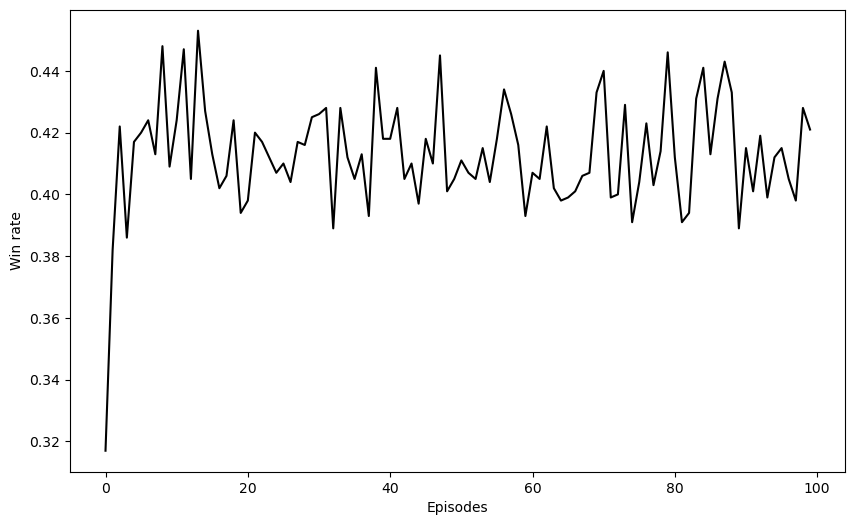

In [64]:
# Train the agent
sarsa_agent.train()

In [70]:
# Test the agent
sarsa_agent.test()

Average Reward over 1000 episodes: 43.5


## Training the model

This snippet is a simulation of the reinforcement learning agent playing Blackjack. 

The agent is using a custom environment called `BlackjackEnv` and an `Agent` class, both previously defined here. The agent is trained over a set number of episodes (30000), where it takes actions based on a Q-table and updates the Q-table based on the rewards received from each action. The simulation is run for 1000 rounds with 1000 samples to calculate the average payout per round. The agent's average payout is then plotted and printed, with the running average present for easier comprehension.

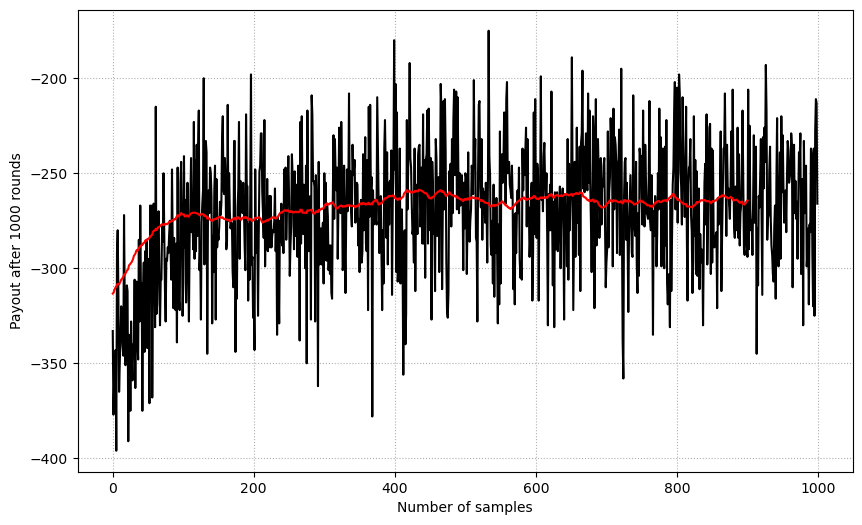

Average payout after 1000 rounds is: -271.051


In [71]:
# Loading the custom model
env = BlackjackEnv()

agent = Agent(env, epsilon=1.0, alpha=0.1, gamma=0.01, num_episodes_to_train=30000)

num_rounds = 1000 # Payout calculated over num_rounds
num_samples = 1000 # num_rounds simulated over num_samples

average_rewards = []

state = tuple(env.reset())
for sample in range(num_samples):
    round = 1
    total_rewards = 0 # to store total payout over 'num_rounds'
    # Take action based on Q-table of the agent and learn based on that until 'num_episodes_to_train' = 0
    while round <= num_rounds:
        action = agent.choose_action(state)
        next_state, reward, is_done, _ = env.step(action)
        next_state = tuple(next_state)
        next_action = agent.choose_action(next_state)
        agent.learn(state, action, reward, next_state, next_action)
        total_rewards += reward
        if is_done:
            state = tuple(env.reset()) # Environment deals new cards to player and dealer
            round += 1
    average_rewards.append(total_rewards)
    agent.update_parameters(sample)

avg_run = moving_average(average_rewards)

# Plot payout per 1000 episodes for episode
plt.figure(figsize=(10,6))
plt.plot(average_rewards, 'k-')
plt.plot(avg_run, 'r-')
plt.xlabel('Number of samples')
plt.ylabel('Payout after {} rounds'.format(num_rounds))
plt.grid(linestyle=':')
plt.show()      
    
print ("Average payout after {} rounds is: {}".format(num_rounds, sum(average_rewards)/(num_samples)))


In [26]:
#print(average_payouts)
print(agent.epsilon)
print(agent.alpha)
print(agent.gamma)

0.1
0.1
0.8
